<a href="https://colab.research.google.com/github/luizrhamada/desafio_bootcamp_unisenai/blob/main/desafio_bootcamp_LuizRodrigoHamada_finalizado.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Desafio Bootcamp UniSenai

**Descrição do desafio**: Uma empresa do setor siderúrgico contratou você para a criação de um sistema inteligente de controle de qualidade para chapas de aço inoxidável. Essa empresa forneceu um conjunto de dados contendo informações extraídas a partir de imagens de superfície das chapas, com o objetivo de detectar e classifi car defeitos automaticamente. Cada amostra no conjunto de dados é composta por 31 indicadores que descrevem aspectos geométricos e estatísticos do defeito identifi cado, como área, perímetro, índices de orientação, luminosidade e proporção de bordas. Além dessas características, cada amostra é rotulada com uma das sete possíveis classes de defeitos (seis categorias específi cas e uma categoria genérica de “outros defeitos”).

O sistema deverá ser capaz de, a partir do cadastro de uma nova imagem (ou conjunto de medições), prever a classe do defeito e retornar a probabilidade associada. Além disso, a empresa espera que você extraia insights da operação e dos defeitos e gere visualizações de dados.

Abaixo, já iniciei importando algumas bibliotecas que já sei que serão utilizandas e outras que possivelmente sejam utilizadas

In [2]:
!pip install numpy==1.23.5
!pip install sweetviz
!pip install ydata_profiling

  Using cached sweetviz-2.3.1-py3-none-any.whl.metadata (24 kB)
Using cached sweetviz-2.3.1-py3-none-any.whl (15.1 MB)
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 400.1/400.1 kB 7.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 18.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 687.8/687.8 kB 26.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 105.4/105.4 kB 6.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.3/43.3 kB 2.6 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=327d340eb00f87391e63cac6aedaec75c5f90f9c1d5446dc5c0c397a062ccf74
  Stored in directory: /root/.cache/pip/wheels/8d/55/1a/19cd535375ed1ede0c996405ebffe34b196d78e2d9545723a2
Successfully built htmlmin


In [217]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as stats
import sweetviz as sv

from matplotlib.colors import LinearSegmentedColormap
from scipy.cluster.hierarchy import dendrogram, linkage
from scipy.spatial.distance import squareform
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, classification_report, confusion_matrix
from sklearn.preprocessing import LabelEncoder, MinMaxScaler, StandardScaler
from sklearn.tree import DecisionTreeClassifier, DecisionTreeRegressor
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor, IsolationForest
from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering
from sklearn.model_selection import train_test_split
from sklearn.impute import SimpleImputer
from sklearn.mixture import BayesianGaussianMixture
from sklearn.decomposition import PCA
from sklearn.neighbors import LocalOutlierFactor, KNeighborsClassifier
from sklearn.feature_selection import VarianceThreshold
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.neural_network import MLPClassifier
from matplotlib.patches import Circle
from datetime import datetime
from pandas_profiling import ProfileReport


Como primeiro passa, vou iniciar realizando o carregamento do dataset

In [218]:
dados = pd.read_csv("/content/desafio_bootcamp/bootcamp_train2.csv", sep=',', encoding='utf-8', decimal=',')

df = pd.DataFrame(dados)
df.head()

,id,x_minimo,x_maximo,y_minimo,y_maximo,peso_da_placa,area_pixels,perimetro_x,perimetro_y,soma_da_luminosidade,maximo_da_luminosidade,comprimento_do_transportador,tipo_do_aço_A300,tipo_do_aço_A400,espessura_da_chapa_de_aço,temperatura,index_de_bordas,index_vazio,index_quadrado,index_externo_x,indice_de_bordas_x,indice_de_bordas_y,indice_de_variacao_x,indice_de_variacao_y,indice_global_externo,log_das_areas,log_indice_x,log_indice_y,indice_de_orientaçao,indice_de_luminosidade,sigmoide_das_areas,minimo_da_luminosidade,falha_1,falha_2,falha_3,falha_4,falha_5,falha_6,falha_outros
0,0,154,169.0,260124,260136,100,75,27,17,9948.0,143.0,1364,Não,sim,40.0,80.79956986765761,0.2258,0.5833,0.8,0.011,0.5556,0.7059,0.14901424590336979,0.14901424590336979,0.0,1.8751,1.1761,1.0792,-0.2,0.0362,0.3068,125,False,0,False,False,não,False,Sim
1,1,1121,-186.0,1789332,1789337,100,-206,9,-194,2240.0,150.0,-214,Não,sim,50.0,79.7907206368532,0.3412,0.5143,0.7143,0.0052,0.7778,0.8333,-0.0414792903513554,-0.0414792903513554,0.0,1.2305,0.8451,0.699,-0.2857,0.0294,0.1441,115,False,False,False,True,Não,False,Não
2,2,41,216.0,2708878,2708939,100,6298,275,134,654634.0,126.0,1358,não,sim,40.0,80.87197048276663,0.0604,0.41,0.3486,0.1289,0.6364,0.4552,-0.08996214192594132,-0.054971962461439816,0.0,3.7992,2.243,1.7853,-0.6514,-0.1879,1.0,42,False,False,True,False,não,False,Não
3,3,129,157.0,86408,86427,100,276,39,26,33858.0,135.0,1362,Não,Sim,40.0,77.48224695837098,0.1894,0.4812,0.6786,0.0206,0.7179,0.7308,0.2546862386013201,0.45103519272356735,0.0,2.4409,1.4472,1.2787,-0.3214,-0.0416,0.8223,115,False,False,True,False,não,False,Não
4,4,436,442.0,4959398,530985,100,63,17,17,6374.0,116.0,1356,1,Não,70.0,73.85454987445387,0.6431,0.3823,0.3529,0.0044,0.3529,1.0,0.9297539875829992,-0.07024601241700079,1.0,1.7993,0.7782,1.2305,0.6471,-0.2096,0.2083,90,False,True,False,False,Não,False,Não


Agora vou realizar algumas visualizações para iniciar a limpeza e tratamento

In [219]:
pd.set_option('display.max_columns', None)
print(df.shape) # (389, 32)
# print(df.head()) # apresentando as cinco primeiras linhas
# print(df.tail()) # apresentado as últimas cinco linhas


(3390, 39)


É possível verificar que para todas as 31 variáveis, não há informações nulas do DataFrame.

In [220]:
print(df.head()) # apresentando as cinco primeiras linhas
# print(df.tail()) # apresentado as últimas cinco linhas


   id  x_minimo x_maximo  y_minimo  y_maximo  peso_da_placa  area_pixels  \
0   0       154    169.0    260124    260136            100           75   
1   1      1121   -186.0   1789332   1789337            100         -206   
2   2        41    216.0   2708878   2708939            100         6298   
3   3       129    157.0     86408     86427            100          276   
4   4       436    442.0   4959398    530985            100           63   

   perimetro_x  perimetro_y soma_da_luminosidade maximo_da_luminosidade  \
0           27           17               9948.0                  143.0   
1            9         -194               2240.0                  150.0   
2          275          134             654634.0                  126.0   
3           39           26              33858.0                  135.0   
4           17           17               6374.0                  116.0   

   comprimento_do_transportador tipo_do_aço_A300 tipo_do_aço_A400  \
0                      

É possível verificar que há valores nulos no DataFrame

In [221]:
df.info()
print()
print(df.isnull().values.any())
print(df.isnull().sum())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3390 entries, 0 to 3389
Data columns (total 39 columns):
 #   Column                        Non-Null Count  Dtype 
---  ------                        --------------  ----- 
 0   id                            3390 non-null   int64 
 1   x_minimo                      3390 non-null   int64 
 2   x_maximo                      3334 non-null   object
 3   y_minimo                      3390 non-null   int64 
 4   y_maximo                      3390 non-null   int64 
 5   peso_da_placa                 3390 non-null   int64 
 6   area_pixels                   3390 non-null   int64 
 7   perimetro_x                   3390 non-null   int64 
 8   perimetro_y                   3390 non-null   int64 
 9   soma_da_luminosidade          3290 non-null   object
 10  maximo_da_luminosidade        3292 non-null   object
 11  comprimento_do_transportador  3390 non-null   int64 
 12  tipo_do_aço_A300              3390 non-null   object
 13  tipo_do_aço_A400  

Primeiro, analisando as informações anteriores, é importante entender que existem diferentes tipos de colunas com valores nulos, colunas categóricas (como tipo_do_aço_A400), colunas numéricas (como espessura_da_chapa_de_aço) e booleanas (falha_5, falha_6 etc).

Vamos analisar caso a caso:

 12  tipo_do_aço_A300              
 13  tipo_do_aço_A400              
 32  falha_1                       
 33  falha_2                       
 34  falha_3                       
 35  falha_4                       
 36  falha_5                          
 37  falha_6                       
 38  falha_outros                 


In [222]:
# 1. Converter colunas numéricas que estão como object
cols_to_float = [
    'x_maximo', 'soma_da_luminosidade', 'maximo_da_luminosidade',
    'espessura_da_chapa_de_aço', 'temperatura', 'index_de_bordas',
    'index_vazio', 'index_quadrado', 'index_externo_x',
    'indice_de_bordas_x', 'indice_de_bordas_y', 'indice_de_variacao_x',
    'indice_de_variacao_y', 'indice_global_externo', 'log_das_areas',
    'log_indice_x', 'log_indice_y', 'indice_de_orientaçao',
    'indice_de_luminosidade', 'sigmoide_das_areas'
]

for col in cols_to_float:
    # Primeiro substitui vírgulas por pontos para números com decimais
    df[col] = df[col].astype(str).str.replace(',', '.')
    # Converte para float, tratando possíveis erros
    df[col] = pd.to_numeric(df[col], errors='coerce')

df.info() # verifica que as colunas que antes eram do tipo object agora são numéricas do tipo float

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3390 entries, 0 to 3389
Data columns (total 39 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   id                            3390 non-null   int64  
 1   x_minimo                      3390 non-null   int64  
 2   x_maximo                      3334 non-null   float64
 3   y_minimo                      3390 non-null   int64  
 4   y_maximo                      3390 non-null   int64  
 5   peso_da_placa                 3390 non-null   int64  
 6   area_pixels                   3390 non-null   int64  
 7   perimetro_x                   3390 non-null   int64  
 8   perimetro_y                   3390 non-null   int64  
 9   soma_da_luminosidade          3290 non-null   float64
 10  maximo_da_luminosidade        3292 non-null   float64
 11  comprimento_do_transportador  3390 non-null   int64  
 12  tipo_do_aço_A300              3390 non-null   object 
 13  tip

Vou agora converter os valores booleanos para 0 (False) e 1 (True):

12 tipo_do_aço_A300
13 tipo_do_aço_A400
32 falha_1
33 falha_2
34 falha_3
35 falha_4
36 falha_5
37 falha_6
38 falha_outros

In [223]:
# Vejamos como estão apresentados:

print(f"Tipo de Aço 300: {df['tipo_do_aço_A300'].unique()}")
print(f"Tipo de Aço 400: {df['tipo_do_aço_A400'].unique()}")
print(f"Falha 1: {df['falha_1'].unique()}")
print(f"Falha 2: {df['falha_2'].unique()}")
print(f"Falha 3: {df['falha_3'].unique()}")
print(f"Falha 4: {df['falha_4'].unique()}")
print(f"Falha 5: {df['falha_5'].unique()}")
print(f"Falha 6: {df['falha_6'].unique()}")
print(f"Outras falhas: {df['falha_outros'].unique()}")



Tipo de Aço 300: ['Não' 'não' '1' 'Sim' 'sim' '0' 'N' '-']
Tipo de Aço 400: ['sim' 'Sim' 'Não' 'não' nan '1' '0' 'S' 'nao']
Falha 1: ['False' '0' '1' 'True' 'nao' 'S']
Falha 2: ['0' 'False' 'True' 'y' '1' 'S']
Falha 3: [False  True]
Falha 4: ['False' 'True' 'nao' '0' 'S' '1']
Falha 5: ['não' 'Não' 'Sim' 'sim']
Falha 6: [False  True]
Outras falhas: ['Sim' 'Não']


É possível observar que não se trata da descrição de tipos específicos de defeitos, mas sim se há ou não defeitos. É possível resolver essas inconsistência utilizando formato booleano criando uma função onde ela irá varrer todas as colunhas falhas dentro o dataframe e retornar somente em valores booleanos de False e True:

In [224]:
# Colunas: 'falha_1', 'falha_2', 'falha_3', 'falha_4', 'falha_5', 'falha_6', 'falha_outros'

def falha_padronizada(falha):
  if isinstance(falha, str):
    falha = falha.strip().lower()
    if falha in ['1', 'true', 's', 'y', 'sim']:
      return 1
    elif falha in ['false', '0', 'nao', 'não']:
      return 0
  elif isinstance(falha, bool):
    return 1 if falha else 0
  elif isinstance(falha, (int, float)):
    return 1 if falha == 1 else 0

falhas = ['falha_1', 'falha_2', 'falha_3', 'falha_4', 'falha_5', 'falha_6', 'falha_outros']

df[falhas] = df[falhas].applymap(falha_padronizada)

print(f"Falha 1: {df['falha_1'].unique()}")
print(f"Falha 2: {df['falha_2'].unique()}")
print(f"Falha 3: {df['falha_3'].unique()}")
print(f"Falha 4: {df['falha_4'].unique()}")
print(f"Falha 5: {df['falha_5'].unique()}")
print(f"Falha 6: {df['falha_6'].unique()}")
print(f"Outras falhas: {df['falha_outros'].unique()}")


# Colunas: 'tipo_do_aço_A300', 'tipo_do_aço_A400'

# Tipo de Aço A300: ['Não' 'não' '1' 'Sim' 'sim' '0' 'N' '-']
# Tipo de Aço A400: ['sim' 'Sim' 'Não' 'não' nan '1' '0' 'S' 'nao']

def tipo_aco_padronizado(valor):
    if pd.isna(valor) or valor is None:
        return pd.NA
    if isinstance(valor, str):
        valor = valor.strip().lower()
        if valor in ['sim', '1', 's', 'y']:
            return 1
        elif valor in ['não', 'não', '0', 'n', 'nao', 'n']:
            return 0
        elif valor == '-':
            return pd.NA

    elif isinstance(valor, bool):
        return 1 if valor else 0
    elif isinstance(valor, (int, float)):
        return 1 if valor == 1 else 0
    return pd.NA

# Lista das colunas que irei padronizar
tipo_de_aco = ['tipo_do_aço_A300', 'tipo_do_aço_A400']

# Aplicando minha função nas colunas
df[tipo_de_aco] = df[tipo_de_aco].applymap(tipo_aco_padronizado)

# Exibe os valores únicos após padronização
print(f"Tipo de Aço A300: {df['tipo_do_aço_A300'].unique()}")
print(f"Tipo de Aço A400: {df['tipo_do_aço_A400'].unique()}")

Falha 1: [0 1]
Falha 2: [0 1]
Falha 3: [0 1]
Falha 4: [0 1]
Falha 5: [0 1]
Falha 6: [0 1]
Outras falhas: [1 0]
Tipo de Aço A300: [0 1 <NA>]
Tipo de Aço A400: [1 0 <NA>]


<ipython-input-224-026d681a7d86>:17: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df[falhas] = df[falhas].applymap(falha_padronizada)
<ipython-input-224-026d681a7d86>:55: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df[tipo_de_aco] = df[tipo_de_aco].applymap(tipo_aco_padronizado)


Verificar a distribuição das classes de defeito


Distribuição das classes de defeito:
falhas
falha_outros    1184
falha_6          806
falha_3          649
falha_1          275
falha_2          264
falha_4          116
falha_5           96
Name: count, dtype: int64


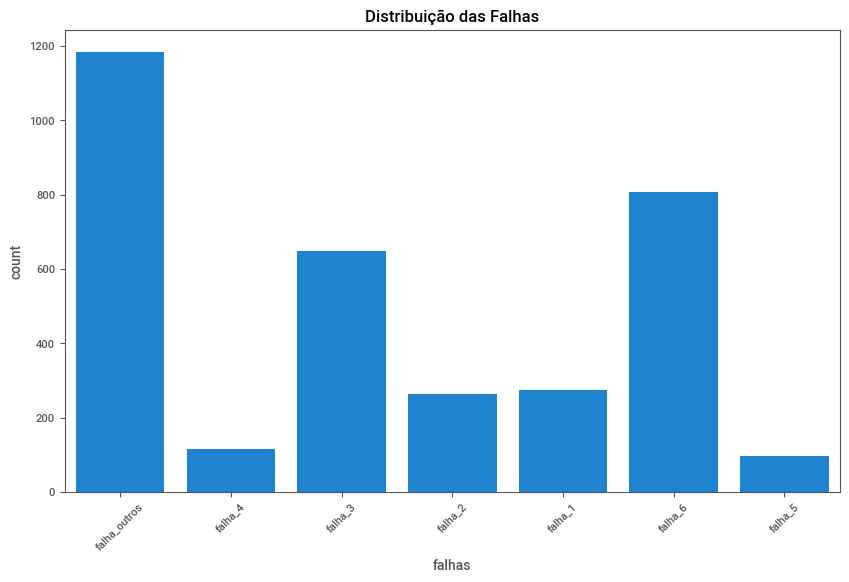

In [225]:
falha_chapa = ['falha_1', 'falha_2', 'falha_3', 'falha_4', 'falha_5', 'falha_6', 'falha_outros']
df['falhas'] = df[falha_chapa].idxmax(axis=1)
print()
print("Distribuição das classes de defeito:")
print(df['falhas'].value_counts())

plt.figure(figsize=(10, 6))
sns.countplot(data=df, x='falhas')
plt.title('Distribuição das Falhas')
plt.xticks(rotation=45)
plt.show()


Vou realizar a separação entre as features e a target

In [226]:
X = df.drop(falha_chapa + ['falhas', 'id'], axis=1)
y = df['falhas']
print(X)
print(y)


      x_minimo  x_maximo  y_minimo  y_maximo  peso_da_placa  area_pixels  \
0          154     169.0    260124    260136            100           75   
1         1121    -186.0   1789332   1789337            100         -206   
2           41     216.0   2708878   2708939            100         6298   
3          129     157.0     86408     86427            100          276   
4          436     442.0   4959398    530985            100           63   
...        ...       ...       ...       ...            ...          ...   
3385       779     802.0    402237    402266            100          755   
3386        41     188.0    327823    327870            100         3437   
3387       823     834.0    323844    323852            100          135   
3388      9505    -186.0    949856    949874            100         -206   
3389      1181    1191.0   1146871   1146879            100           12   

      perimetro_x  perimetro_y  soma_da_luminosidade  maximo_da_luminosidade  \
0      

Agora vou calculas as métricas estatísticas (média, valor máximo, mínimo, desvio padrão, moda, mediana) que serão utilziadas para o calculo do IQR.

VOu preencher as variáveis numéricas com o valor da mediana e as categóricas com o valor da moda

In [227]:
print("Valores ausentes antes do tratamento: ")
print(df.isnull().sum())

for col in df.columns:
    if df[col].dtype in ['int64', 'float64']:
        df[col].fillna(df[col].median(), inplace=True)
    else:
        if df[col].nunique() < 25:
            df[col].fillna(df[col].mode()[0], inplace=True)

print()
print("Valores ausentes após do tratamento:")
print(df.isnull().sum())

# 3. Criar variável target combinando as colunas de falha
falha_chapa = ['falha_1', 'falha_2', 'falha_3', 'falha_4', 'falha_5', 'falha_6', 'falha_outros']
df['defeito_principal'] = df[falha_chapa].idxmax(axis=1)

Valores ausentes antes do tratamento: 
id                                0
x_minimo                          0
x_maximo                         56
y_minimo                          0
y_maximo                          0
peso_da_placa                     0
area_pixels                       0
perimetro_x                       0
perimetro_y                       0
soma_da_luminosidade            100
maximo_da_luminosidade           98
comprimento_do_transportador      0
tipo_do_aço_A300                  6
tipo_do_aço_A400                 76
espessura_da_chapa_de_aço        41
temperatura                       0
index_de_bordas                   0
index_vazio                       0
index_quadrado                   36
index_externo_x                   0
indice_de_bordas_x                0
indice_de_bordas_y                0
indice_de_variacao_x              0
indice_de_variacao_y              0
indice_global_externo            59
log_das_areas                     0
log_indice_x             

<ipython-input-227-3d57ebcfdbab>:6: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[col].fillna(df[col].median(), inplace=True)
<ipython-input-227-3d57ebcfdbab>:9: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try usin

In [228]:
# df.info() # para verificar quais as colunas que farei as métricas

def calcular_estatisticas(df, columns):

  for i in columns:
    media = df[i].mean()
    moda = stats.mode(df[i], keepdims=True).mode[0]
    desvio_padrao = df[i].std()
    valor_maximo = df[i].max()
    valor_minimo = df[i].min()

    print(f"\nEstatísticas para a coluna '{i}':")
    print(f"Média: {media:.2f}")
    print(f"Moda: {moda if isinstance(moda, str) else f'{moda:.2f}'}")
    print(f"Desvio Padrão: {desvio_padrao:.2f}")
    print(f"Valor Máximo: {valor_maximo}")
    print(f"Valor Mínimo: {valor_minimo}")

numeric_cols = df.select_dtypes(include=['int64', 'float64']).columns

calcular_estatisticas(df, numeric_cols)


Estatísticas para a coluna 'id':
Média: 1694.50
Moda: 0.00
Desvio Padrão: 978.75
Valor Máximo: 3389
Valor Mínimo: 0

Estatísticas para a coluna 'x_minimo':
Média: 995.51
Moda: -11.00
Desvio Padrão: 1796.74
Valor Máximo: 15266
Valor Mínimo: -11

Estatísticas para a coluna 'x_maximo':
Média: 604.88
Moda: -186.00
Desvio Padrão: 543.59
Valor Máximo: 1713.0
Valor Mínimo: -186.0

Estatísticas para a coluna 'y_minimo':
Média: 2692639.62
Moda: -20.00
Desvio Padrão: 5625692.78
Valor Máximo: 104136555
Valor Mínimo: -20

Estatísticas para a coluna 'y_maximo':
Média: 1592301.39
Moda: -166.00
Desvio Padrão: 1821345.27
Valor Máximo: 12917094
Valor Mínimo: -166

Estatísticas para a coluna 'peso_da_placa':
Média: 100.00
Moda: 100.00
Desvio Padrão: 0.00
Valor Máximo: 100
Valor Mínimo: 100

Estatísticas para a coluna 'area_pixels':
Média: 1566.32
Moda: -206.00
Desvio Padrão: 4337.68
Valor Máximo: 152655
Valor Mínimo: -206

Estatísticas para a coluna 'perimetro_x':
Média: 66.73
Moda: -229.00
Desvio Padr

É possível verificar que não linhas duplicadas no nosso DataFrame

In [229]:
print(df.duplicated().values.any())

False


In [230]:
print(df.nunique())

id                              3390
x_minimo                        1136
x_maximo                         945
y_minimo                        2017
y_maximo                        1809
peso_da_placa                      1
area_pixels                      850
perimetro_x                      363
perimetro_y                      294
soma_da_luminosidade            1783
maximo_da_luminosidade            91
comprimento_do_transportador      83
tipo_do_aço_A300                   2
tipo_do_aço_A400                   2
espessura_da_chapa_de_aço         24
temperatura                     3390
index_de_bordas                 1347
index_vazio                     1286
index_quadrado                   745
index_externo_x                  433
indice_de_bordas_x               778
indice_de_bordas_y               618
indice_de_variacao_x            3390
indice_de_variacao_y            3390
indice_global_externo              3
log_das_areas                    862
log_indice_x                     177
l

Para dar sequência na análise exploratória, vou realizar o cálculo do IQR para todas as variáveis numéricas e tratar os outliers. Existem algunas procedimentos para o tratamento de outliers (como z-score, por exemplo). Primeiramente, vou buscar aplicar os conceitos visto em sala de aula e gerar os gráficos boxplot e histograma, para antyes e depois da remoção


Remoção de outliers utilizando o Método IQR:
Com outliers: 3390
Sem outliers (IQR): 990
Quantidade de outliers removidos: 2400


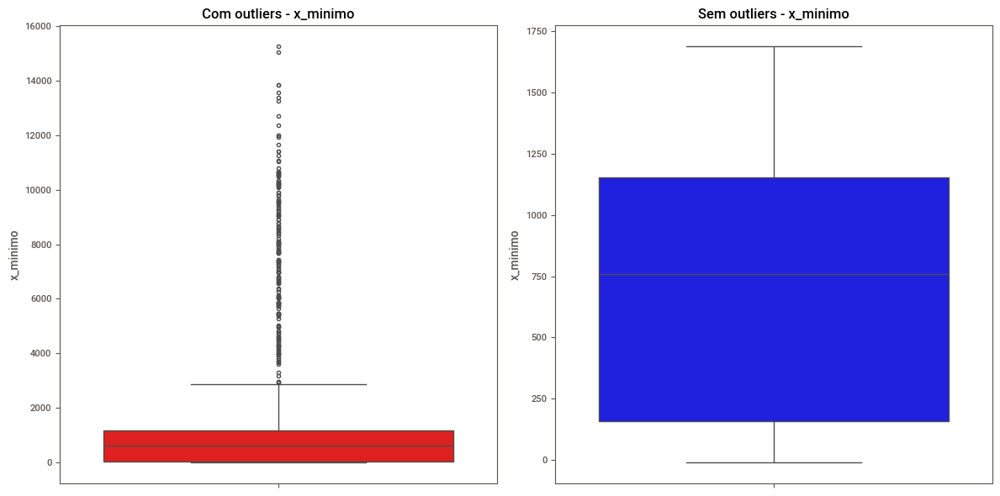

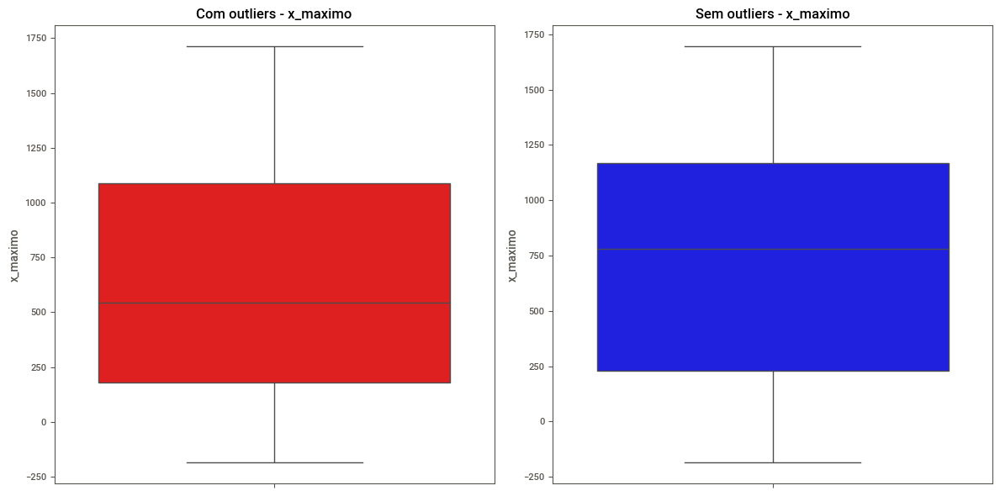

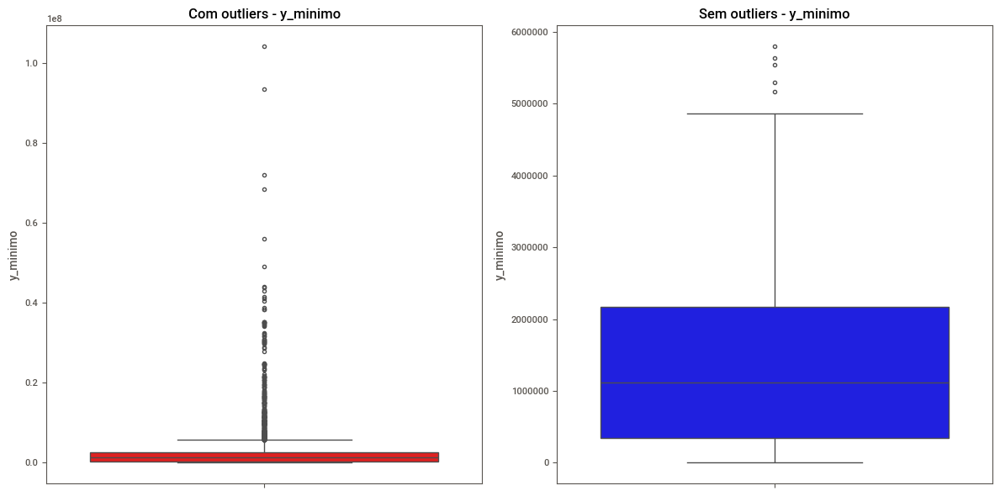

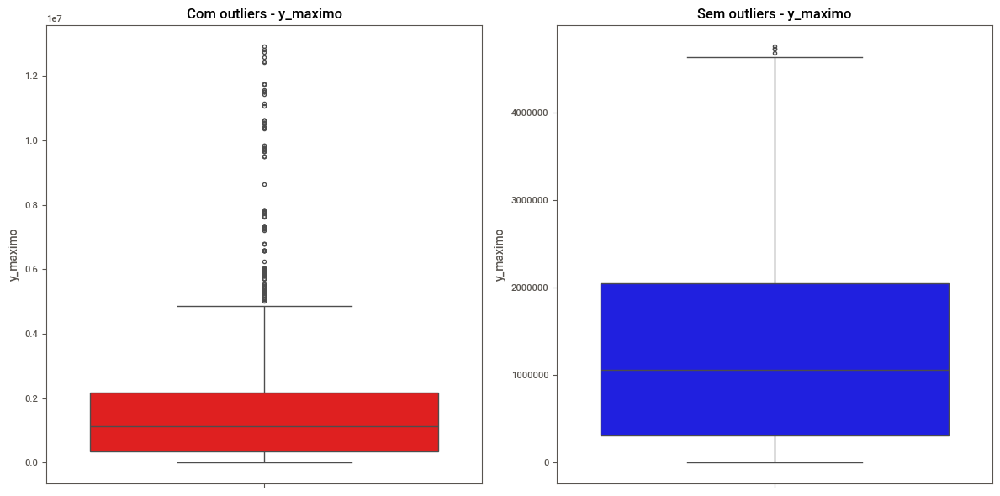

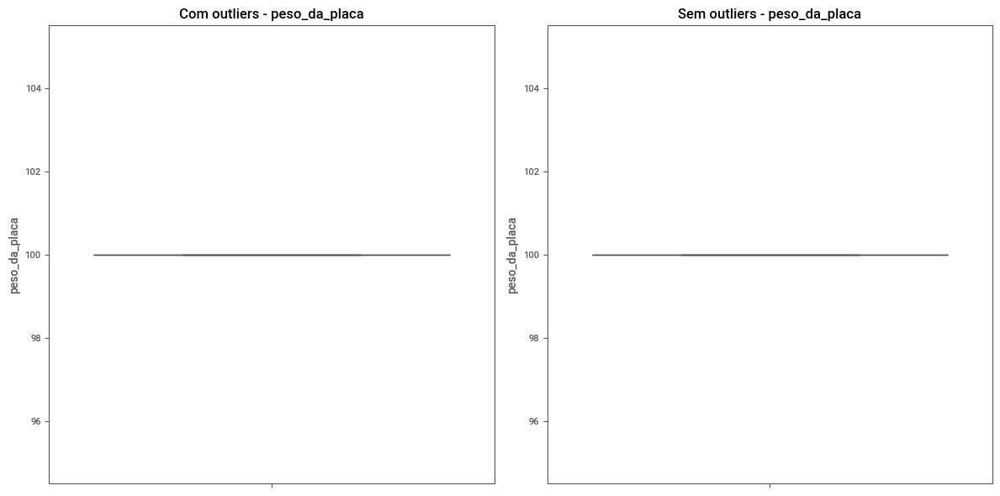

...

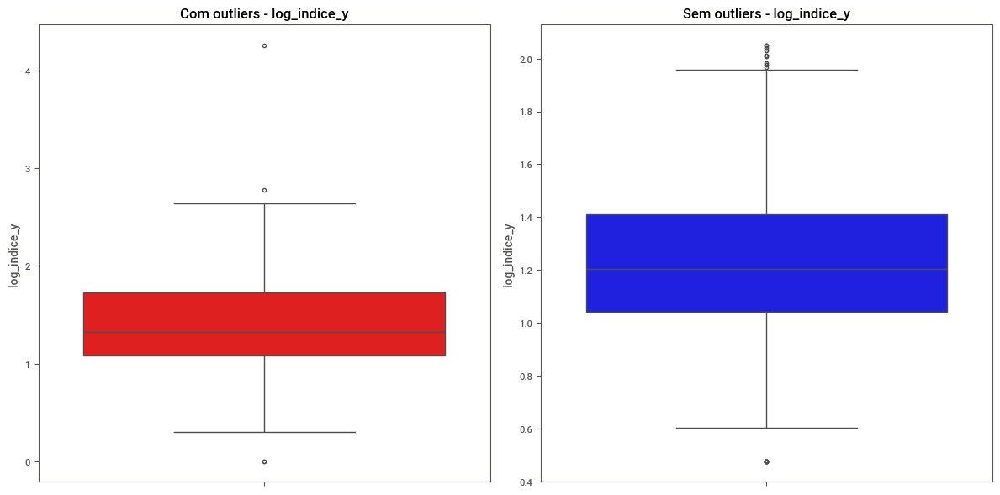

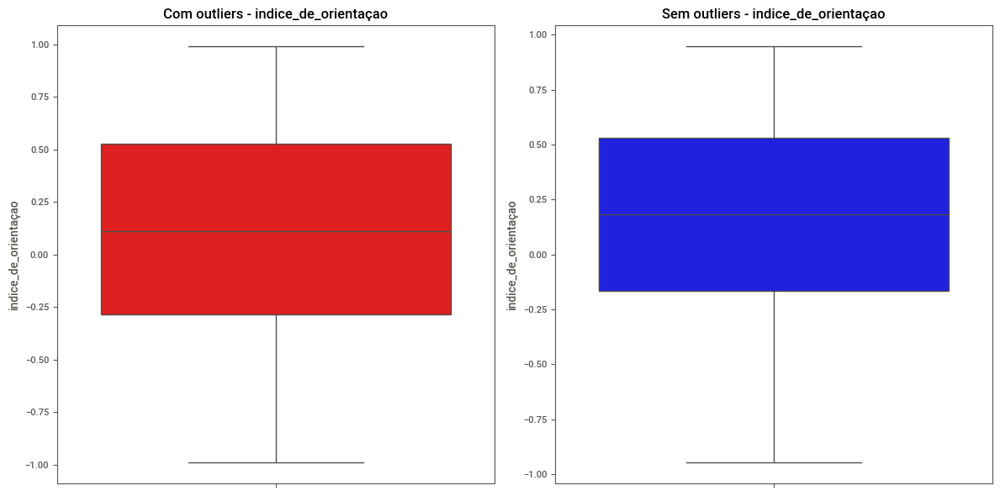

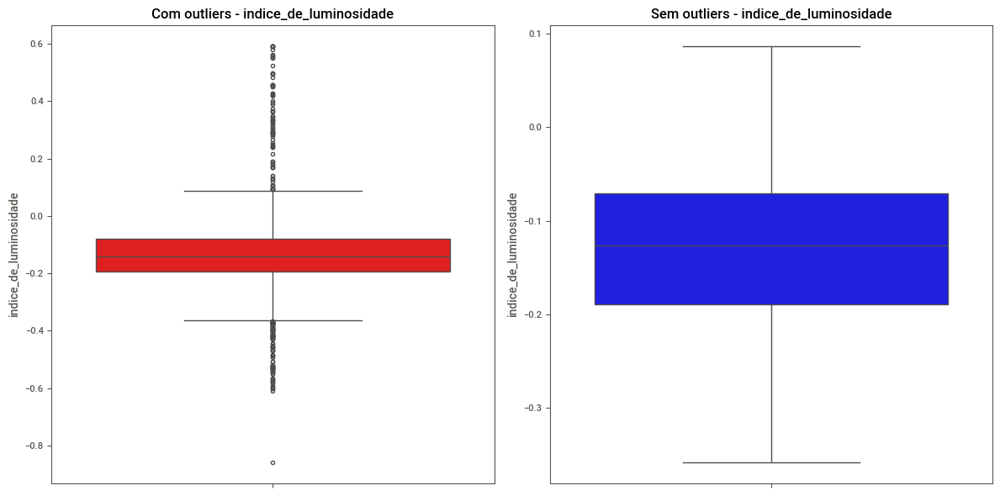

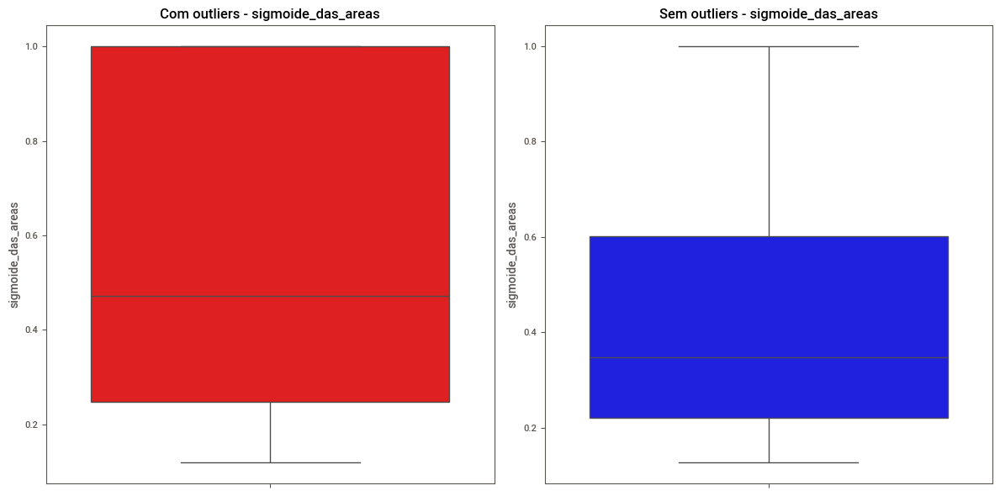

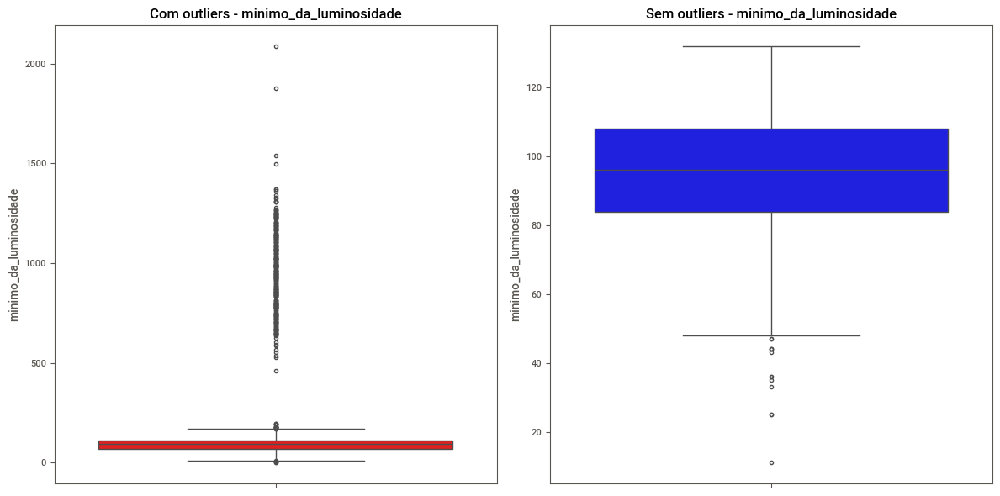

In [231]:
def remover_outliers_iqr(df, columns):
  df_clean = df.copy()
  for i in columns:
    if df_clean[i].dtype in ['int64', 'float64']:
      Q1 = df[i].quantile(0.25)  # Primeiro quartil (25%)
      Q3 = df[i].quantile(0.75)  # Terceiro quartil (75%)
      IQR = Q3 - Q1  # Intervalo interquartil
      limite_inf = Q1 - 1.5 * IQR
      limite_sup = Q3 + 1.5 * IQR

      df_clean = df_clean[(df_clean[i] >= limite_inf) & (df_clean[i] <= limite_sup)]

  return df_clean

# Selecionando colunas numéricas para análise de outliers, exceto a ID
cols_df_clean = df.select_dtypes(include=['int64', 'float64']).columns
cols_df_clean = [col for col in cols_df_clean if col not in ['id'] + falha_chapa]

# Removendo os outliers
print("\nRemoção de outliers utilizando o Método IQR:")
df_clean_iqr = remover_outliers_iqr(df, cols_df_clean)

print(f"Com outliers: {len(df)}")
print(f"Sem outliers (IQR): {len(df_clean_iqr)}")
print(f"Quantidade de outliers removidos: {len(df) - len(df_clean_iqr)}")

# Gerando os Boxplots
for coluna in cols_df_clean:
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    sns.boxplot(data=df, y=coluna, color="red")
    plt.title(f"Com outliers - {coluna}")

    plt.subplot(1, 2, 2)
    sns.boxplot(data=df_clean_iqr, y=coluna, color="blue")
    plt.title(f"Sem outliers - {coluna}")

    plt.tight_layout()
    plt.show()

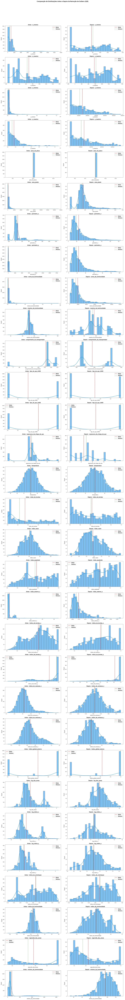

In [232]:
# Histograma para ver a distribuição

# Selecionando colunas numéricas (as mesmas usadas no IQR)
numeric_cols = [col for col in cols_df_clean if df[col].dtype in ['int64', 'float64']]

n_cols = 2  # Antes e depois
n_rows = len(numeric_cols)

fig, axes = plt.subplots(n_rows, n_cols, figsize=(16, 4*n_rows))
fig.suptitle('Comparação de Distribuições Antes e Depois da Remoção de Outliers (IQR)', y=1.02, fontsize=14)

for i, col in enumerate(numeric_cols):
    sns.histplot(df[col], kde=True, ax=axes[i,0], bins=30)
    axes[i,0].axvline(df[col].mean(), color='red', linestyle='--', label='Média')
    axes[i,0].axvline(df[col].median(), color='green', linestyle=':', label='Mediana')
    axes[i,0].set_title(f'Antes - {col}')
    axes[i,0].legend()

    sns.histplot(df_clean_iqr[col], kde=True, ax=axes[i,1], bins=30)
    axes[i,1].axvline(df_clean_iqr[col].mean(), color='red', linestyle='--', label='Média')
    axes[i,1].axvline(df_clean_iqr[col].median(), color='green', linestyle=':', label='Mediana')
    axes[i,1].set_title(f'Depois - {col}')
    axes[i,1].legend()

plt.tight_layout()
plt.show()





# # Histograma antes da remoção de outliers - SLIDES

# plt.figure(figsize=(12, 5))

# plt.subplot(1, 2, 1)
# sns.histplot(df['area_pixels'], kde=True, bins=30)
# plt.axvline(df['area_pixels'].mean(), color='red', linestyle='--', label='Média')
# plt.axvline(df['area_pixels'].median(), color='green', linestyle=':', label='Mediana')
# plt.title('Distribuição de area_pixels (Antes)')
# plt.legend()

# # Histograma depois da remoção de outliers

# plt.subplot(1, 2, 2)
# sns.histplot(df_clean_iqr['area_pixels'], kde=True, bins=30)
# plt.axvline(df_clean_iqr['area_pixels'].mean(), color='red', linestyle='--', label='Média')
# plt.axvline(df_clean_iqr['area_pixels'].median(), color='green', linestyle=':', label='Mediana')
# plt.title('Distribuição de area_pixels (Depois)')
# plt.legend()

# plt.tight_layout()
# plt.show()

Vou realizar o mesmo procedimento dos outliers utilizando agora o método Isolation Forest, robusto para dados multivariados


Remoção de outliers com Isolation Forest:

Removidos 170 outliers com Isolation Forest (contaminação=0.05)
Com outliers: 3390
Sem outliers (Isolation Forest): 3220
Quantidade de outliers removidos: 170


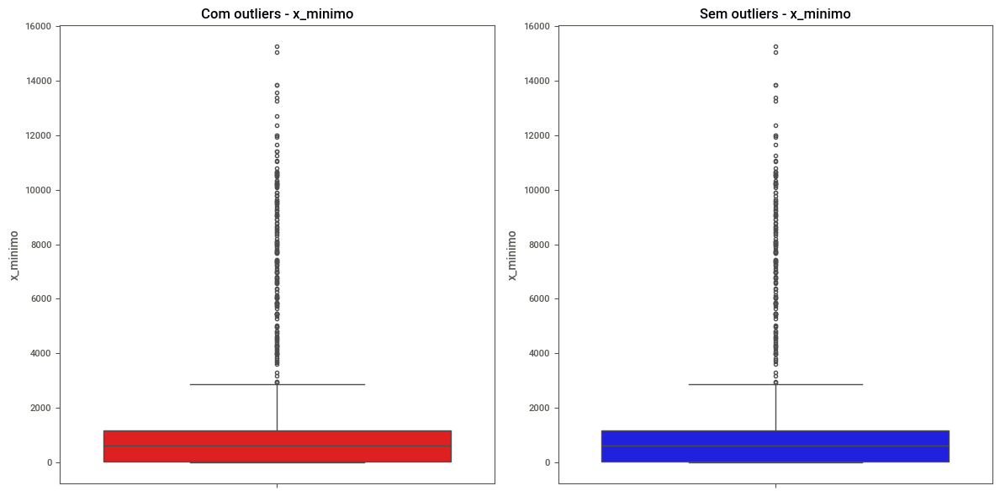

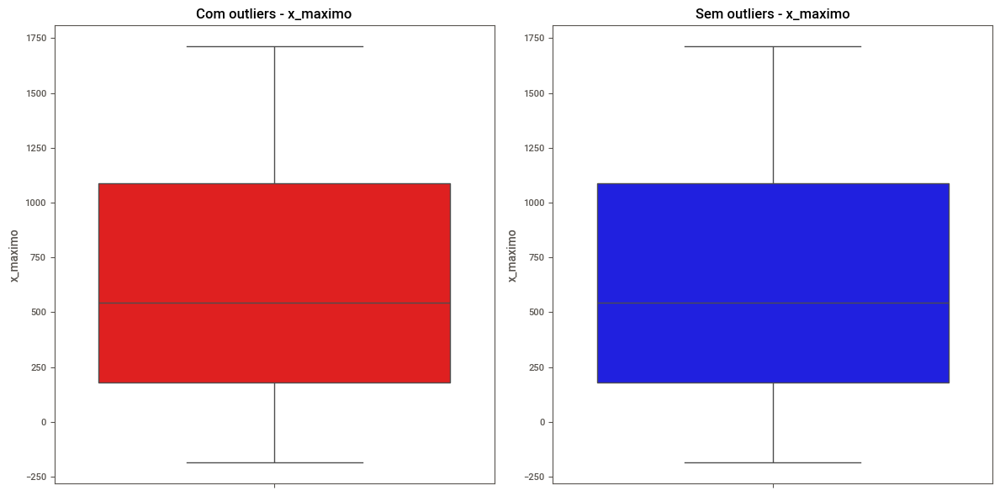

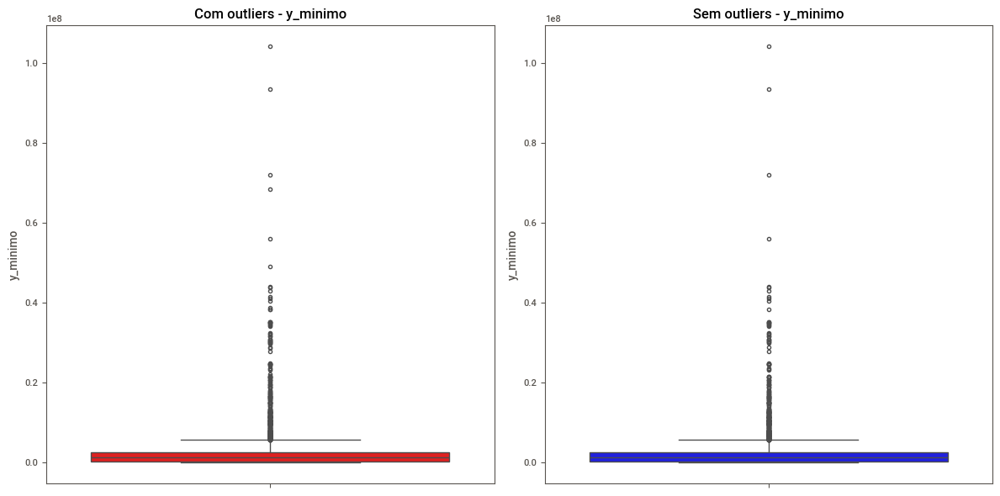

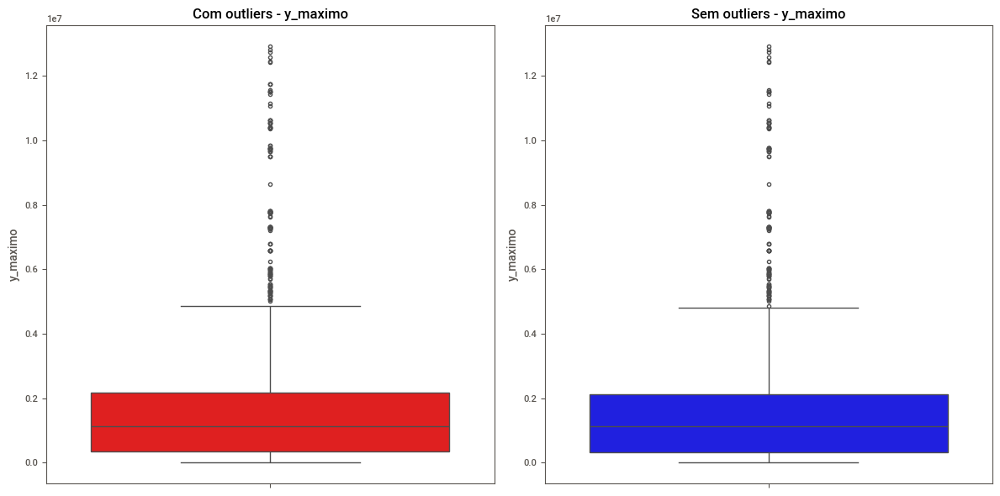

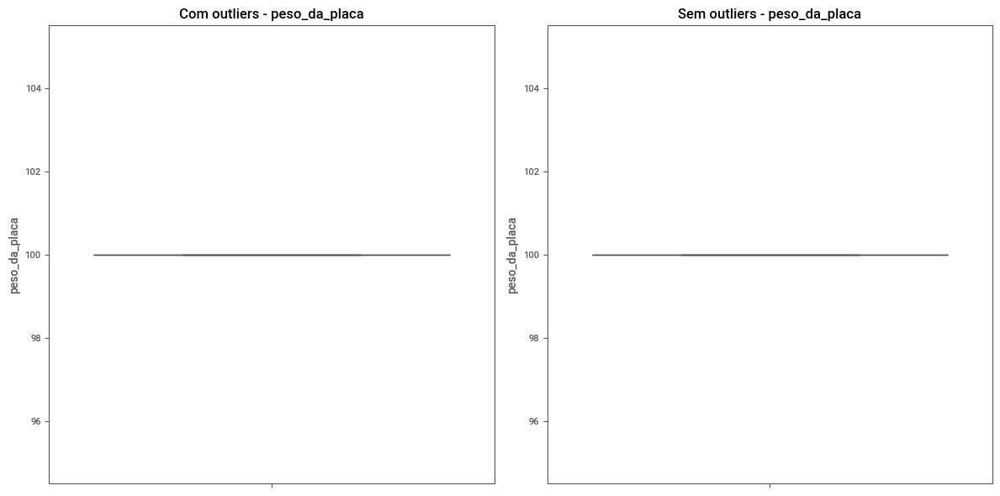

...

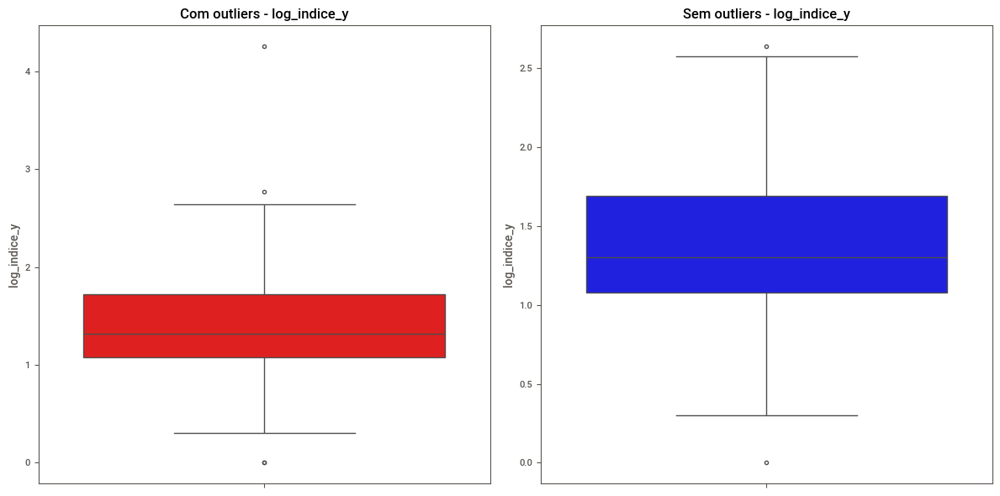

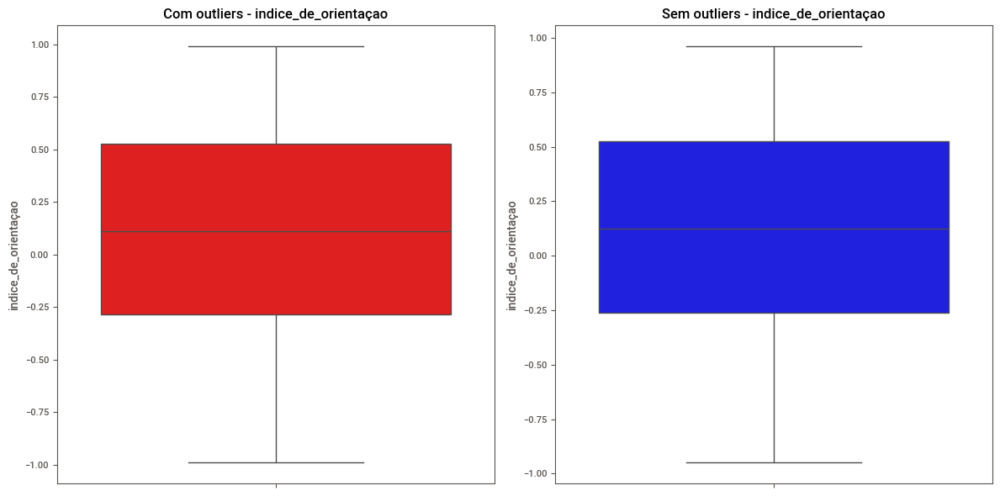

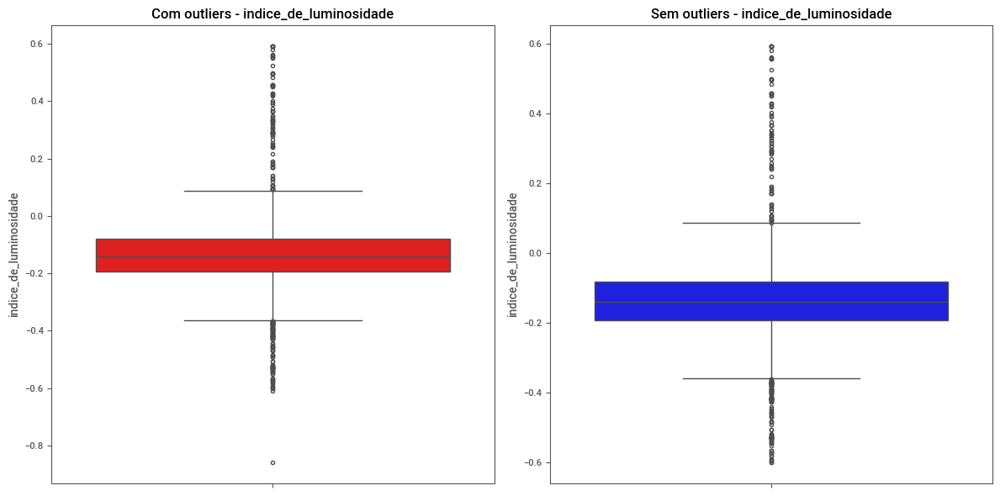

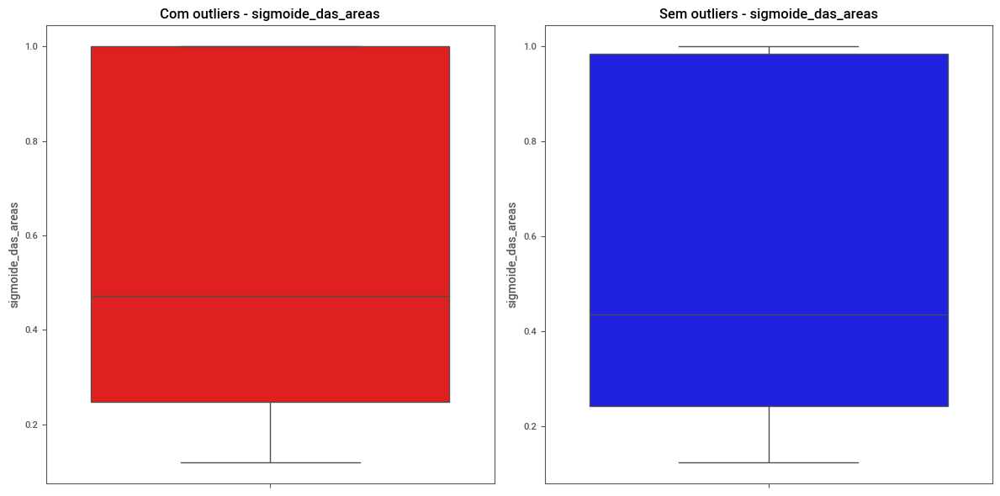

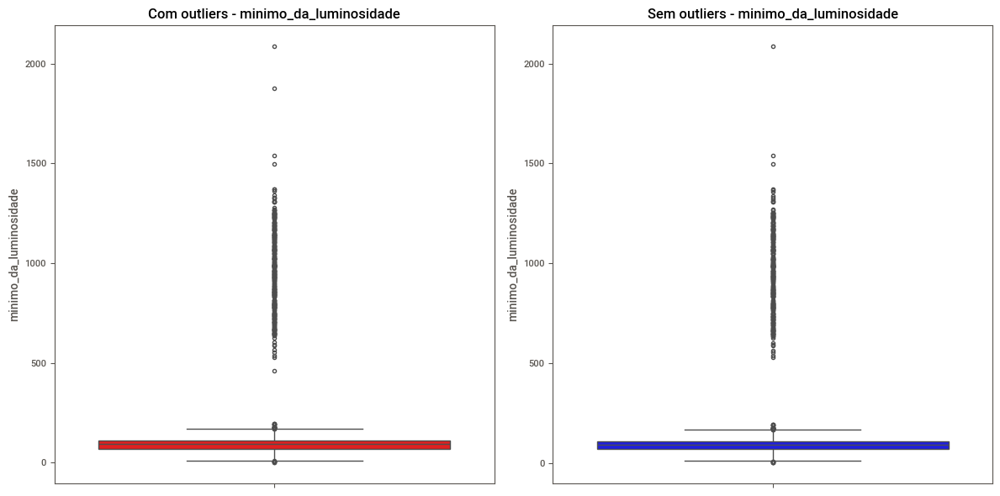

In [233]:
def remove_outliers_isolation(df, numeric_cols, contamination=0.05):

    iso_forest = IsolationForest(
        contamination=contamination,
        random_state=42)
    outliers = iso_forest.fit_predict(df[numeric_cols])

    df_clean = df[outliers == 1]

    print(f"\nRemovidos {len(df) - len(df_clean)} outliers com Isolation Forest (contaminação={contamination})")
    return df_clean

print("\nRemoção de outliers com Isolation Forest:")
df_clean_forest = remove_outliers_isolation(df, numeric_cols)

print(f"Com outliers: {len(df)}")
print(f"Sem outliers (Isolation Forest): {len(df_clean_forest)}")
print(f"Quantidade de outliers removidos: {len(df) - len(df_clean_forest)}")


# Boxplots para os SLIDES
# plt.figure(figsize=(12, 6))

# plt.subplot(1, 2, 1)
# sns.boxplot(y=df['perimetro_x'], color="red")  # Sem `data=`, usando `y=`
# plt.title(f"Com outliers - perimetro_x")

# plt.subplot(1, 2, 2)
# sns.boxplot(y=df_clean_forest['perimetro_x'], color="blue")
# plt.title(f"Sem outliers - perimetro_x")

# plt.tight_layout()
# plt.show()


# Gerando os Boxplots
for coluna in cols_df_clean:
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    sns.boxplot(data=df, y=coluna, color="red")
    plt.title(f"Com outliers - {coluna}")

    plt.subplot(1, 2, 2)
    sns.boxplot(data=df_clean_forest, y=coluna, color="blue")
    plt.title(f"Sem outliers - {coluna}")

    plt.tight_layout()
    plt.show()

# # Visualizar a distribuição antes e depois da limpeza
# fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 8))

# # Boxplot antes da remoção
# sns.boxplot(data=df[numeric_cols], ax=axes[0])
# axes[0].set_title('Antes da Remoção de Outliers (Isolation Forest)')
# axes[0].tick_params(axis='x', rotation=45)

# # Boxplot após a remoção
# sns.boxplot(data=df_clean_forest[numeric_cols], ax=axes[1])
# axes[1].set_title('Após Remoção de Outliers (Isolation Forest)')
# axes[1].tick_params(axis='x', rotation=45)

# plt.tight_layout()
# plt.show()

Realizando um comparativo utilizando o gráficoHISTOGRAMA do antes e depois da remoção dos outliers utilizando o método IQR para cada variável numérica

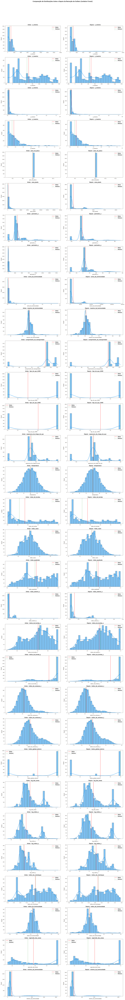

In [234]:
# Histograma para ver a distribuição com Isolation Forest

numeric_cols = [col for col in cols_df_clean if df[col].dtype in ['int64', 'float64']]

n_cols = 2
n_rows = len(numeric_cols)

fig, axes = plt.subplots(n_rows, n_cols, figsize=(16, 4*n_rows))
fig.suptitle('Comparação de Distribuições Antes e Depois da Remoção de Outliers (Isolation Forest)', y=1.02, fontsize=14)

for i, col in enumerate(numeric_cols):
    sns.histplot(df[col], kde=True, ax=axes[i,0], bins=30)
    axes[i,0].axvline(df[col].mean(), color='red', linestyle='--', label='Média')
    axes[i,0].axvline(df[col].median(), color='green', linestyle=':', label='Mediana')
    axes[i,0].set_title(f'Antes - {col}')
    axes[i,0].legend()

    sns.histplot(df_clean_forest[col], kde=True, ax=axes[i,1], bins=30)
    axes[i,1].axvline(df_clean_forest[col].mean(), color='red', linestyle='--', label='Média')
    axes[i,1].axvline(df_clean_forest[col].median(), color='green', linestyle=':', label='Mediana')
    axes[i,1].set_title(f'Depois - {col}')
    axes[i,1].legend()

plt.tight_layout()
plt.show()



# # Histograma antes da remoção de outliers - SLIDES

# plt.figure(figsize=(12, 5))

# plt.subplot(1, 2, 1)
# sns.histplot(df['perimetro_x'], kde=True, bins=30)
# plt.axvline(df['perimetro_x'].mean(), color='red', linestyle='--', label='Média')
# plt.axvline(df['perimetro_x'].median(), color='green', linestyle=':', label='Mediana')
# plt.title('Distribuição de perimetro_x (Antes)')
# plt.legend()

# # Histograma depois da remoção de outliers

# plt.subplot(1, 2, 2)
# sns.histplot(df_clean_iqr['perimetro_x'], kde=True, bins=30)
# plt.axvline(df_clean_iqr['perimetro_x'].mean(), color='red', linestyle='--', label='Média')
# plt.axvline(df_clean_iqr['perimetro_x'].median(), color='green', linestyle=':', label='Mediana')
# plt.title('Distribuição de perimetro_x (Depois)')
# plt.legend()

# plt.tight_layout()
# plt.show()

Comparando a eficiência da aplica dos métodos de outliers

In [235]:
def comparar_eficacia_outliers(df_original, df_iqr, df_forest, numeric_cols):

    resultados = []

    for col in numeric_cols:
        dados_sem_tratamento = {
            'Método': 'Dados sem tratamento',
            'Coluna': col,
            'Média': df[col].mean(),
            'Desvio Padrão': df[col].std(),
            'Mediana': df[col].median(),
            'Q1': df[col].quantile(0.25),
            'Q3': df[col].quantile(0.75),
            'IQR': df[col].quantile(0.75) - df[col].quantile(0.25),
            'Min': df[col].min(),
            'Max': df[col].max(),
            'Amostras': len(df)
        }

        dados_iqr = {
            'Método': 'IQR',
            'Coluna': col,
            'Média': df_clean_iqr[col].mean(),
            'Desvio Padrão': df_clean_iqr[col].std(),
            'Mediana': df_clean_iqr[col].median(),
            'Q1': df_clean_iqr[col].quantile(0.25),
            'Q3': df_clean_iqr[col].quantile(0.75),
            'IQR': df_clean_iqr[col].quantile(0.75) - df_clean_iqr[col].quantile(0.25),
            'Min': df_clean_iqr[col].min(),
            'Max': df_clean_iqr[col].max(),
            'Amostras': len(df_clean_iqr)
        }

        dados_forest = {
            'Método': 'Isolation Forest',
            'Coluna': col,
            'Média': df_clean_forest[col].mean(),
            'Desvio Padrão': df_clean_forest[col].std(),
            'Mediana': df_clean_forest[col].median(),
            'Q1': df_clean_forest[col].quantile(0.25),
            'Q3': df_clean_forest[col].quantile(0.75),
            'IQR': df_clean_forest[col].quantile(0.75) - df_clean_forest[col].quantile(0.25),
            'Min': df_clean_forest[col].min(),
            'Max': df_clean_forest[col].max(),
            'Amostras': len(df_clean_forest)
        }

        resultados.extend([dados_sem_tratamento, dados_iqr, dados_forest])

    df_resultados = pd.DataFrame(resultados)

    for i in ['Média', 'Desvio Padrão', 'Mediana', 'IQR']:
        df_resultados[f'{i} % Diff'] = df_resultados.groupby('Coluna')[i].transform(
            lambda x: ((x - x.iloc[0]) / x.iloc[0]) * 100 if x.iloc[0] != 0 else 0
        )

    colunas = ['Método', 'Coluna', 'Amostras', 'Média', 'Média % Diff',
                 'Desvio Padrão', 'Desvio Padrão % Diff', 'Mediana', 'Mediana % Diff',
                 'Q1', 'Q3', 'IQR', 'IQR % Diff', 'Min', 'Max']

    return df_resultados[colunas]

# Supondo que você já tenha:
# df (original), df_clean_iqr (após IQR), df_clean_forest (após Isolation Forest)
# e cols_df_clean (colunas numéricas analisadas)

# Chamar a função de comparação
resultado_comparacao = comparar_eficacia_outliers(
    df_original=df,
    df_iqr=df_clean_iqr,
    df_forest=df_clean_forest,
    numeric_cols=cols_df_clean
)

# Análise resumida
print("\nResumo da comparação:")
print(f"Total de amostras original: {len(df)}")
print(f"Amostras após IQR: {len(df_clean_iqr)} ({len(df_clean_iqr)/len(df)*100:.2f}%)")
print(f"Amostras após Isolation Forest: {len(df_clean_forest)} ({len(df_clean_forest)/len(df)*100:.2f}%)")

# Verificando estatisticamente qual presenvou mais os dados
if len(df_clean_iqr) > len(df_clean_forest):
    print("\nO método IQR foi menos agressivo, preservando mais dados.")
elif len(df_clean_iqr) < len(df_clean_forest):
    print("\nO método Isolation Forest foi menos agressivo, preservando mais dados.")
else:
    print("\nAmbos os métodos removeram a mesma quantidade de dados.")

std_iqr = resultado_comparacao[
    resultado_comparacao['Método'] == 'IQR']['Desvio Padrão % Diff'].mean()
std_forest = resultado_comparacao[
    resultado_comparacao['Método'] == 'Isolation Forest']['Desvio Padrão % Diff'].mean()

print(f"\nRedução média do desvio padrão:")
print(f"IQR: {std_iqr:.2f}%")
print(f"Isolation Forest: {std_forest:.2f}%")

if abs(std_iqr) > abs(std_forest):
    print("O método IQR foi mais eficaz em reduzir a variabilidade dos dados.")
else:
    print("O método Isolation Forest foi mais eficaz em reduzir a variabilidade dos dados.")


Resumo da comparação:
Total de amostras original: 3390
Amostras após IQR: 990 (29.20%)
Amostras após Isolation Forest: 3220 (94.99%)

O método Isolation Forest foi menos agressivo, preservando mais dados.

Redução média do desvio padrão:
IQR: -39.87%
Isolation Forest: -7.59%
O método IQR foi mais eficaz em reduzir a variabilidade dos dados.


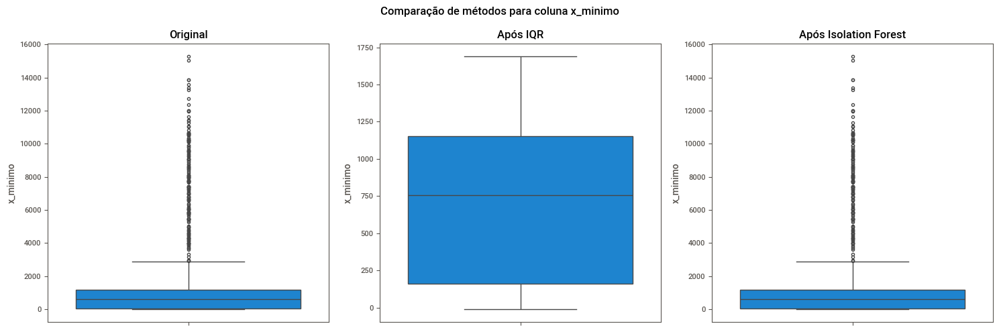

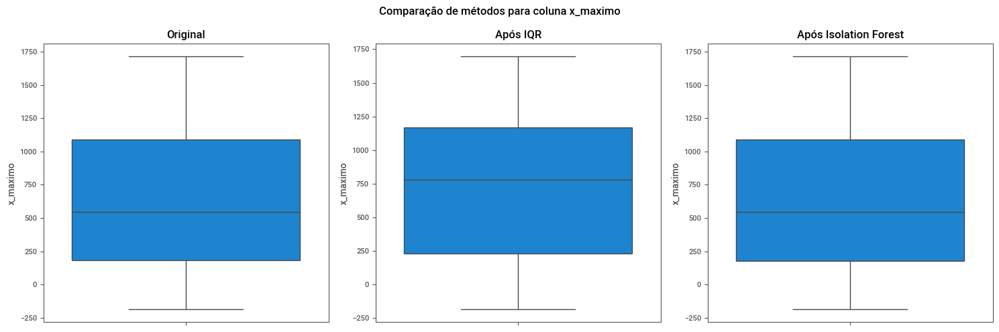

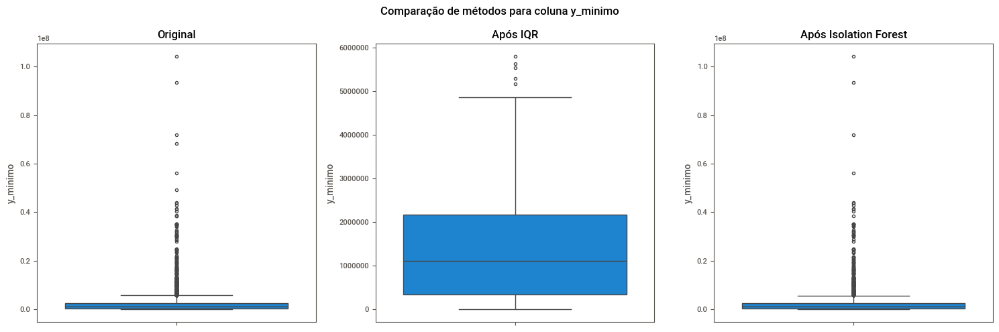

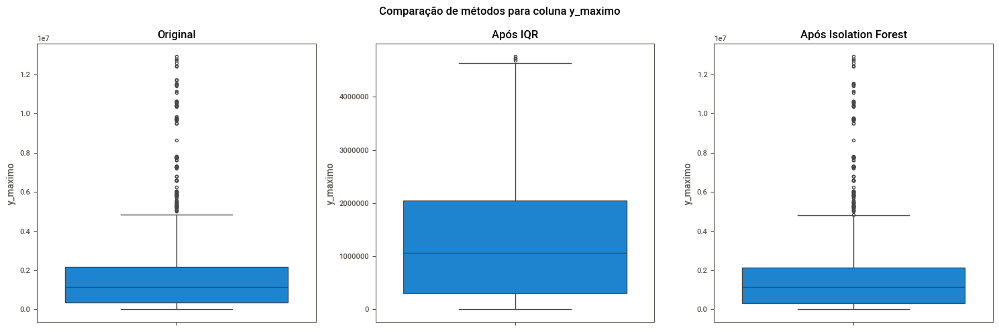

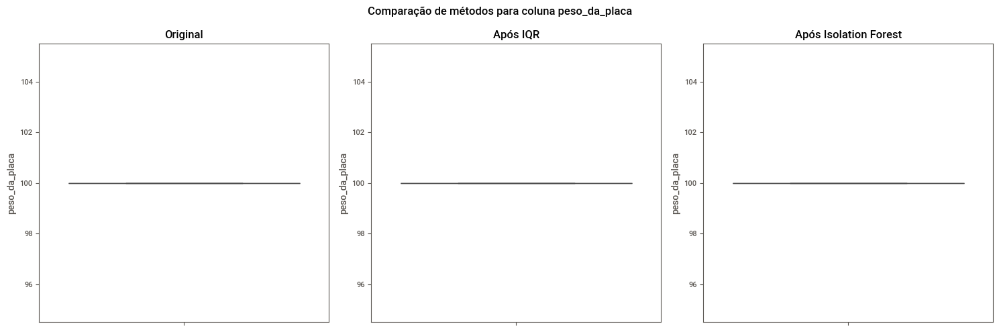

...

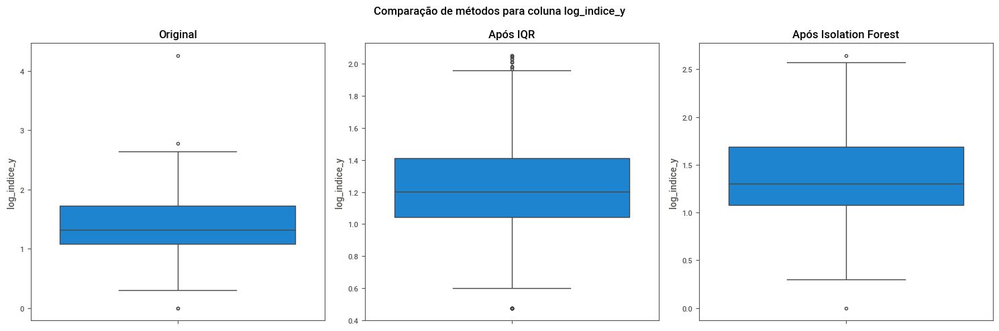

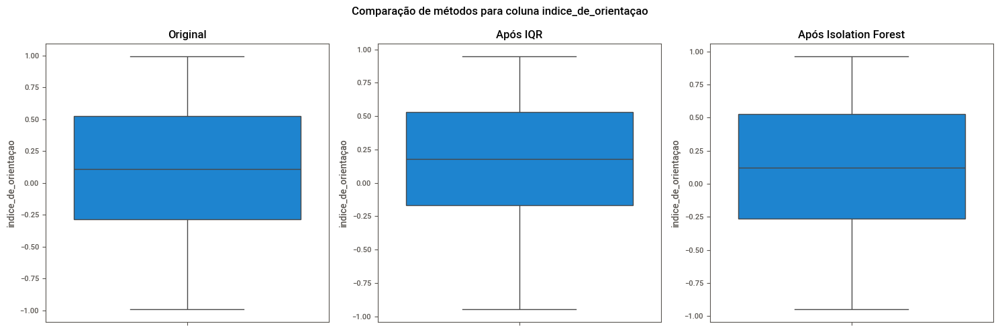

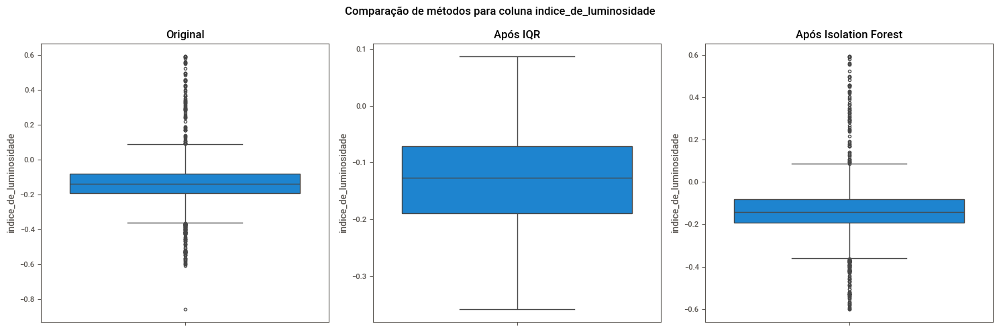

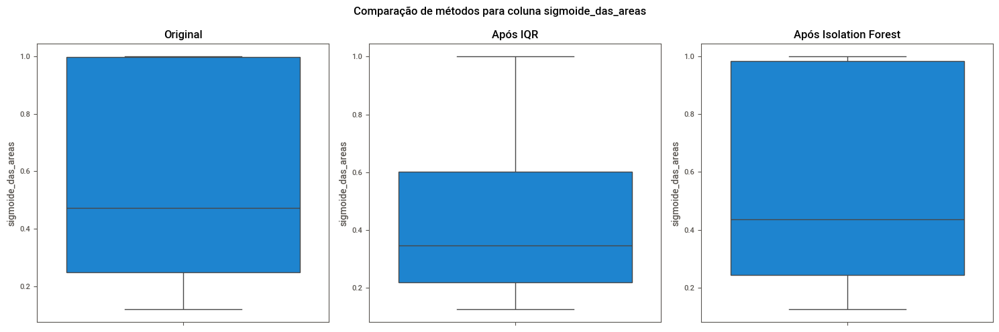

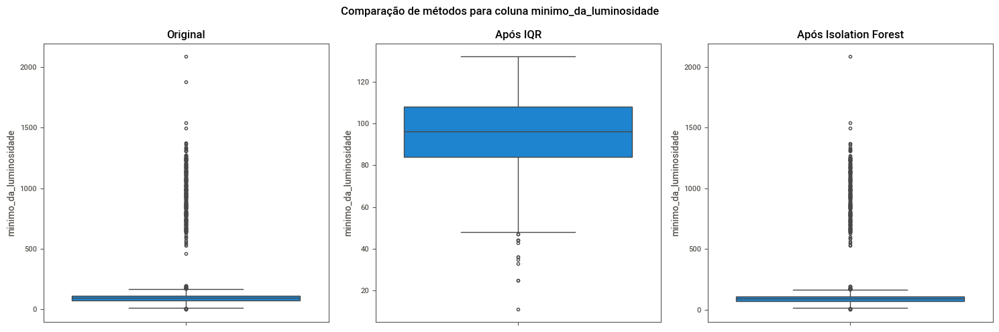

In [236]:
for col in cols_df_clean:
    plt.figure(figsize=(15, 5))
    plt.suptitle(f'Comparação de métodos para coluna {col}')

    plt.subplot(1, 3, 1)
    sns.boxplot(data=df, y=col)
    plt.title('Original')

    plt.subplot(1, 3, 2)
    sns.boxplot(data=df_clean_iqr, y=col)
    plt.title('Após IQR')

    plt.subplot(1, 3, 3)
    sns.boxplot(data=df_clean_forest, y=col)
    plt.title('Após Isolation Forest')

    plt.tight_layout()
    plt.show()

Normalizando os dados

In [237]:
# Utilizando o MinMaxScaler para aplicar o DBSCAN, selecionar apenas colunas numéricas
numeric_cols_dbscan = df_clean_forest.select_dtypes(include=['number']).columns
df_numeric = df_clean_forest[numeric_cols_dbscan]

# Aplicar o scaler apenas nas colunas numéricas
scaler = MinMaxScaler()
# scaler = StandardScaler()
df_normalized_array = scaler.fit_transform(df_numeric)
df_normalized = pd.DataFrame(df_normalized_array, columns=numeric_cols_dbscan)

Vou aplicar o DBSCAN para a remoção dos outliers. O DBSCAN é um algoritmo de agrupamento que identifica pontos densamente agrupados e marca pontos que estão sozinhos em regiões de baixa densidade como ruídos (outliers)

Número total de pontos: 3220
Número de inliers: 1134
Número de outliers detectados: 2086


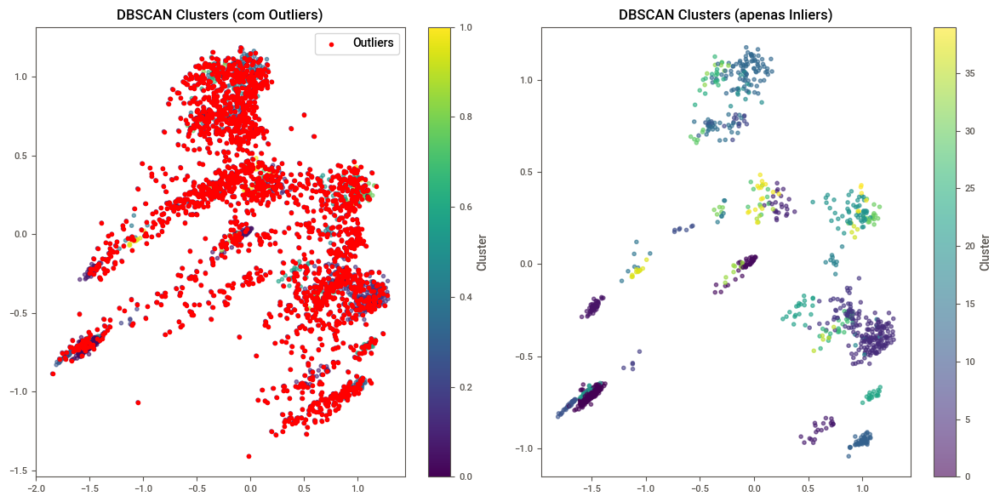

Número total de pontos: 3220
Número de inliers: 1134
Número de outliers detectados: 2086


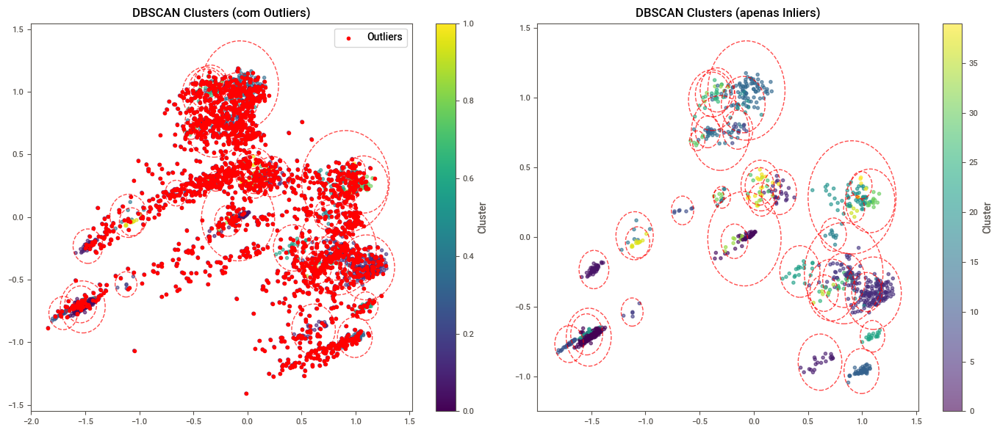

In [238]:
# Aplicando o DBSCAN com MinMaxScaler() sem os circulos

dbscan_eps = DBSCAN(eps=0.5, min_samples=5)
clusters = dbscan_eps.fit_predict(df_normalized)

# Identificando outliers (pontos rotulados como -1)
outliers_mask = clusters == -1
inliers_mask = ~outliers_mask

# Separarndo inliers e outliers
df_normalized_inliers = df_normalized[inliers_mask]
df_normalized_outliers = df_normalized[outliers_mask]

print(f"Número total de pontos: {len(df_normalized)}")
print(f"Número de inliers: {len(df_normalized_inliers)}")
print(f"Número de outliers detectados: {len(df_normalized_outliers)}")


# Criando uma visualização dos clusters
if len(df_normalized.columns) > 2:
    from sklearn.decomposition import PCA
    pca = PCA(n_components=2)
    df_2d = pca.fit_transform(df_normalized)
    df_inliers_2d = pca.transform(df_normalized_inliers)
else:
    df_2d = df_normalized.values
    df_inliers_2d = df_normalized_inliers.values

plt.figure(figsize=(12, 6))

# Plot original com os outliers
plt.subplot(1, 2, 1)
plt.scatter(df_2d[:, 0], df_2d[:, 1], c=clusters, cmap='viridis', alpha=0.6)
plt.scatter(df_2d[clusters == -1, 0], df_2d[clusters == -1, 1], c='red', label='Outliers')
plt.title("DBSCAN Clusters (com Outliers)")
plt.colorbar(label='Cluster')
plt.legend()

# Plot apenas com os inliers
plt.subplot(1, 2, 2)
inlier_clusters = clusters[inliers_mask]
plt.scatter(df_inliers_2d[:, 0], df_inliers_2d[:, 1], c=inlier_clusters, cmap='viridis', alpha=0.6)
plt.title("DBSCAN Clusters (apenas Inliers)")
plt.colorbar(label='Cluster')

plt.tight_layout()
plt.show()


# Aplicando o DBSCAN com MinMaxScaler() com os circulos
dbscan_eps = DBSCAN(eps=0.5, min_samples=5)
clusters = dbscan_eps.fit_predict(df_normalized)

# Identificando outliers (pontos rotulados como -1)
outliers_mask = clusters == -1
inliers_mask = ~outliers_mask

# Separando inliers e outliers
df_normalized_inliers = df_normalized[inliers_mask]
df_normalized_outliers = df_normalized[outliers_mask]


if len(df_normalized.columns) > 2:
    pca = PCA(n_components=2)
    df_2d = pca.fit_transform(df_normalized)
    df_inliers_2d = pca.transform(df_normalized_inliers)
else:
    df_2d = df_normalized.values
    df_inliers_2d = df_normalized_inliers.values

plt.figure(figsize=(14, 6))

# Função criada para desenhar círculos ao redor dos clusters
def draw_cluster_circles(ax, points, clusters, scale_factor=1.0):
    unique_clusters = set(clusters) - {-1}  # Excluindo outliers
    for cluster in unique_clusters:
        cluster_points = points[clusters == cluster]
        if len(cluster_points) > 1:  # Precisa de pelo menos 2 pontos para calcular desvio padrão
            center = np.mean(cluster_points, axis=0)
            radius = np.max(np.linalg.norm(cluster_points - center, axis=1)) * scale_factor
            circle = Circle(center, radius, fill=False, color='red', linestyle='--', alpha=0.7)
            ax.add_patch(circle)

# Plot original com outliers e círculos
ax1 = plt.subplot(1, 2, 1)
plt.scatter(df_2d[:, 0], df_2d[:, 1], c=clusters, cmap='viridis', alpha=0.6)
plt.scatter(df_2d[clusters == -1, 0], df_2d[clusters == -1, 1], c='red', label='Outliers')
draw_cluster_circles(ax1, df_2d, clusters, scale_factor=1.1)
plt.title("DBSCAN Clusters (com Outliers)")
plt.colorbar(label='Cluster')
plt.legend()

# Plot apenas inliers com círculos
ax2 = plt.subplot(1, 2, 2)
inlier_clusters = clusters[inliers_mask]
plt.scatter(df_inliers_2d[:, 0], df_inliers_2d[:, 1], c=inlier_clusters, cmap='viridis', alpha=0.6)
draw_cluster_circles(ax2, df_inliers_2d, inlier_clusters, scale_factor=1.1)
plt.title("DBSCAN Clusters (apenas Inliers)")
plt.colorbar(label='Cluster')

plt.tight_layout()
plt.show()

Fic ao código omentado para teste com o StandardScaler()

Número total de pontos: 3220
Número de inliers: 0
Número de outliers detectados: 3220


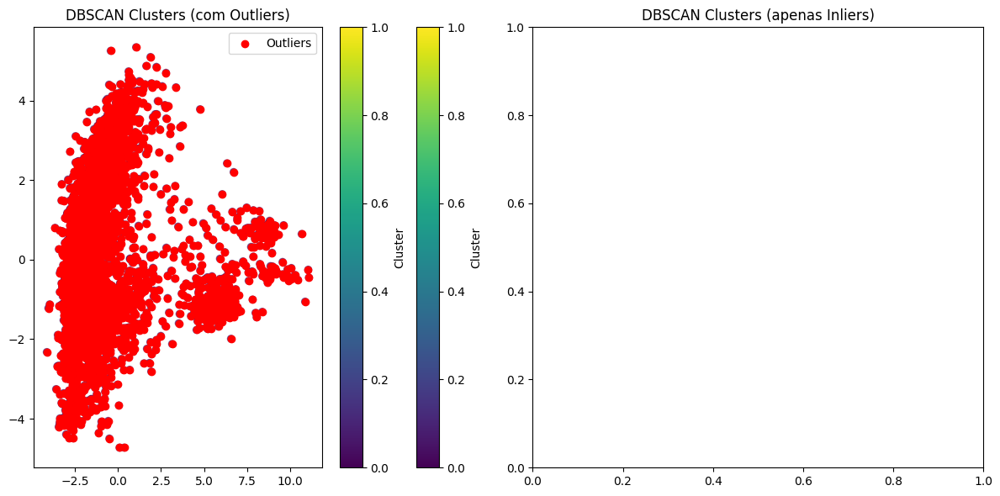

In [97]:
# # Aplicando o DBSCAN com StandardScaler()
# dbscan_eps = DBSCAN(eps=0.6, min_samples=5)
# clusters = dbscan_eps.fit_predict(df_normalized)

# outliers_mask = clusters == -1
# inliers_mask = ~outliers_mask

# df_normalized_inliers = df_normalized[inliers_mask]
# df_normalized_outliers = df_normalized[outliers_mask]

# print(f"Número total de pontos: {len(df_normalized)}")
# print(f"Número de inliers: {len(df_normalized_inliers)}")
# print(f"Número de outliers detectados: {len(df_normalized_outliers)}")


# plt.figure(figsize=(12, 6))

# if len(df_normalized.columns) > 2:
#     from sklearn.decomposition import PCA
#     pca = PCA(n_components=2)
#     df_2d = pca.fit_transform(df_normalized)

#     plt.subplot(1, 2, 1)
#     plt.scatter(df_2d[:, 0], df_2d[:, 1], c=clusters, cmap='viridis', alpha=0.6)
#     if len(df_normalized_outliers) > 0:
#         plt.scatter(df_2d[clusters == -1, 0], df_2d[clusters == -1, 1], c='red', label='Outliers')
#     plt.title("DBSCAN Clusters (com Outliers)")
#     plt.colorbar(label='Cluster')
#     plt.legend()

#     plt.subplot(1, 2, 2)
#     if len(df_normalized_inliers) > 0:
#         df_inliers_2d = pca.transform(df_normalized_inliers)
#         inlier_clusters = clusters[inliers_mask]
#         plt.scatter(df_inliers_2d[:, 0], df_inliers_2d[:, 1], c=inlier_clusters, cmap='viridis', alpha=0.6)
#     plt.title("DBSCAN Clusters (apenas Inliers)")
#     plt.colorbar(label='Cluster')

# else:
#     df_2d = df_normalized.values

#     plt.subplot(1, 2, 1)
#     plt.scatter(df_2d[:, 0], df_2d[:, 1], c=clusters, cmap='viridis', alpha=0.6)
#     if len(df_normalized_outliers) > 0:
#         plt.scatter(df_2d[clusters == -1, 0], df_2d[clusters == -1, 1], c='red', label='Outliers')
#     plt.title("DBSCAN Clusters (com Outliers)")
#     plt.colorbar(label='Cluster')
#     plt.legend()

#     plt.subplot(1, 2, 2)
#     if len(df_normalized_inliers) > 0:
#         df_inliers_2d = df_normalized_inliers.values
#         inlier_clusters = clusters[inliers_mask]
#         plt.scatter(df_inliers_2d[:, 0], df_inliers_2d[:, 1], c=inlier_clusters, cmap='viridis', alpha=0.6)
#     plt.title("DBSCAN Clusters (apenas Inliers)")
#     plt.colorbar(label='Cluster')

# plt.tight_layout()
# plt.show()

Gerando a matriz de correlação

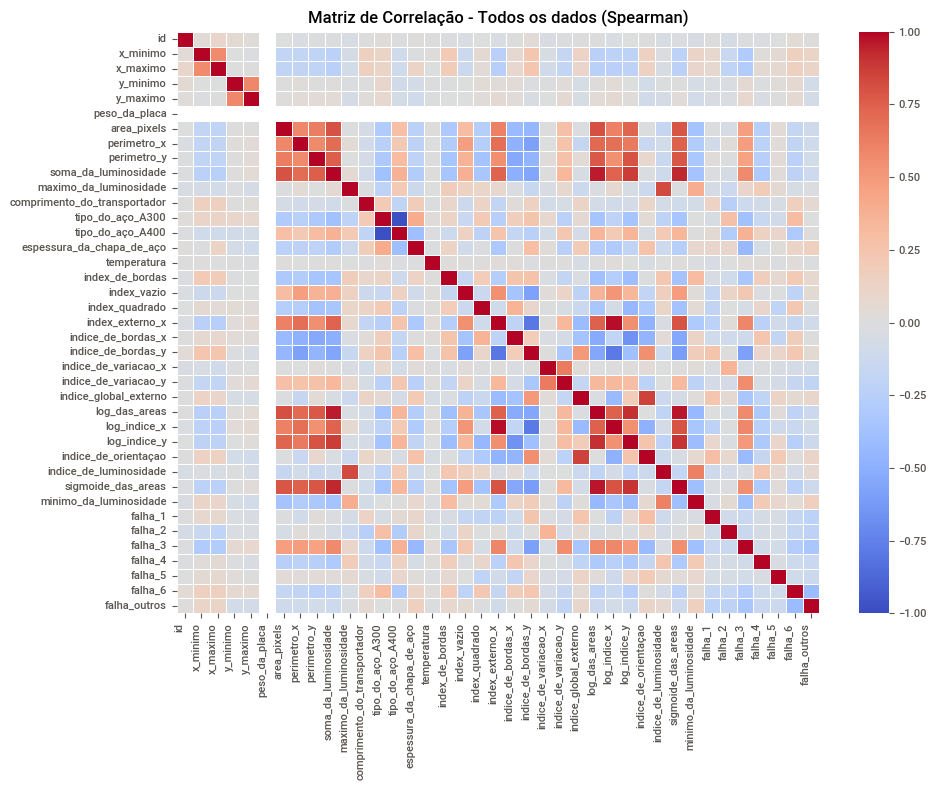

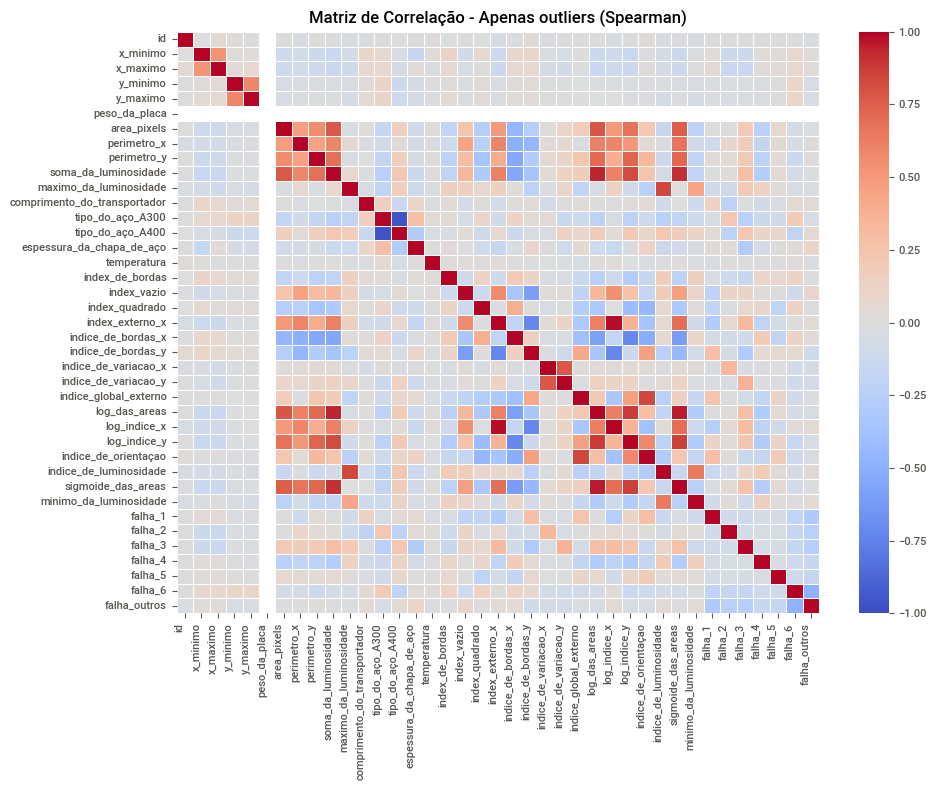

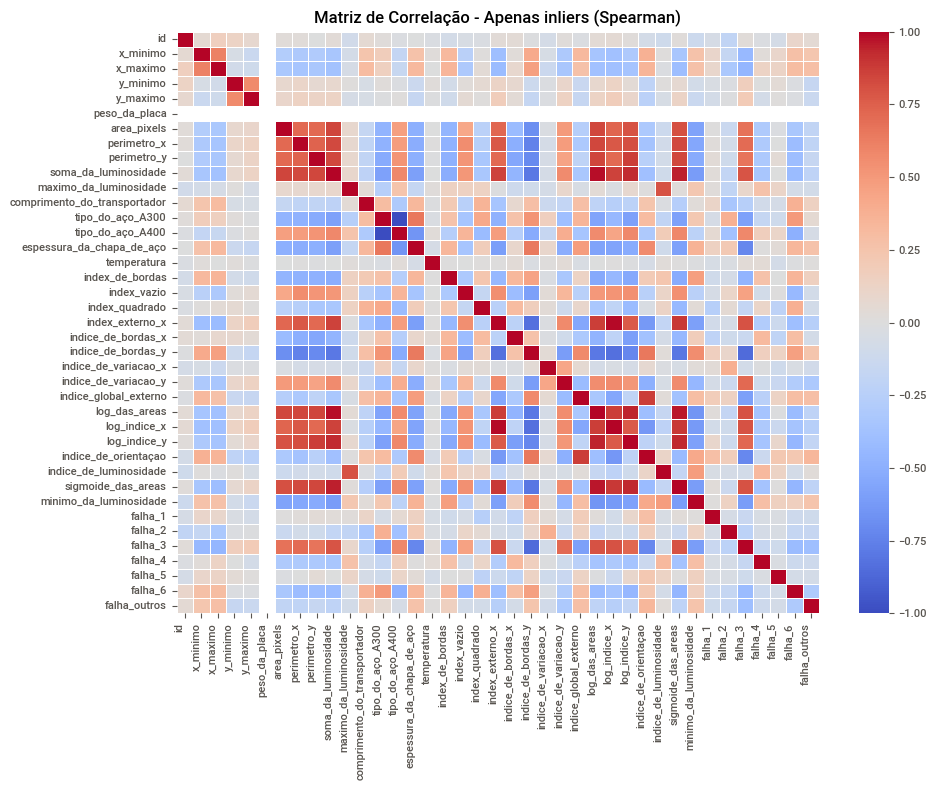

In [239]:
corr_matrix = df_normalized.corr(method='spearman')
corr_matrix_out = df_normalized_outliers.corr(method='spearman')
corr_matrix_in = df_normalized_inliers.corr(method='spearman')

heatmap_kws = {
    'cmap': 'coolwarm',
    'fmt': '.2f',
    # 'annot': True,
    'vmin': -1,
    'vmax': 1,
    'linewidths': 0.5
}

plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, **heatmap_kws)
plt.title('Matriz de Correlação - Todos os dados (Spearman)')
plt.xticks(rotation=90, ha='right')
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix_out, **heatmap_kws)
plt.title('Matriz de Correlação - Apenas outliers (Spearman)')
plt.xticks(rotation=90, ha='right')
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix_in, **heatmap_kws)
plt.title('Matriz de Correlação - Apenas inliers (Spearman)')
plt.xticks(rotation=90, ha='right')
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

Após analisar as matrizes de correlação normalizada, somente com outliers e depois sem os outliers, é possível observar que sem os outliers há uma maior força de correlação entre as variáveis, por assim dizer

In [244]:
variancias = df_normalized_inliers.var()
limiar = 0.01 # esse valor foi na base das tentativas e erros pra vendo qual ficava removia menos ou mais
colunas_baixa_variancia = variancias[variancias < limiar].index.tolist()
print("Colunas candidatas à remoção (baixa variância):", colunas_baixa_variancia)

Colunas candidatas à remoção (baixa variância): ['x_minimo', 'y_minimo', 'peso_da_placa', 'maximo_da_luminosidade', 'indice_de_luminosidade', 'minimo_da_luminosidade']


Correlação entre Features

In [245]:
corr_matrix = df_normalized_inliers.corr().abs()
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))
for col in upper.columns:
    if any(upper[col] > 0.8):  # correlação de mais de 80%, valor sugerido por mim
        print(f"Coluna '{col}' está altamente correlacionada")

Coluna 'perimetro_x' está altamente correlacionada
Coluna 'soma_da_luminosidade' está altamente correlacionada
Coluna 'tipo_do_aço_A400' está altamente correlacionada
Coluna 'index_externo_x' está altamente correlacionada
Coluna 'indice_de_bordas_y' está altamente correlacionada
Coluna 'log_das_areas' está altamente correlacionada
Coluna 'log_indice_x' está altamente correlacionada
Coluna 'log_indice_y' está altamente correlacionada
Coluna 'indice_de_orientaçao' está altamente correlacionada
Coluna 'indice_de_luminosidade' está altamente correlacionada
Coluna 'sigmoide_das_areas' está altamente correlacionada
Coluna 'falha_3' está altamente correlacionada


Montando uam tabela compativa do teste de variância e a correlação entre as features

Coluna 'perimetro_x' está altamente correlacionada com: ['area_pixels']
Coluna 'soma_da_luminosidade' está altamente correlacionada com: ['area_pixels', 'perimetro_x']
Coluna 'tipo_do_aço_A400' está altamente correlacionada com: ['tipo_do_aço_A300']
Coluna 'index_externo_x' está altamente correlacionada com: ['area_pixels', 'soma_da_luminosidade']
Coluna 'indice_de_bordas_y' está altamente correlacionada com: ['area_pixels', 'soma_da_luminosidade', 'index_externo_x']
Coluna 'log_das_areas' está altamente correlacionada com: ['area_pixels', 'soma_da_luminosidade', 'index_externo_x', 'indice_de_bordas_y']
Coluna 'log_indice_x' está altamente correlacionada com: ['area_pixels', 'soma_da_luminosidade', 'index_externo_x', 'indice_de_bordas_y', 'log_das_areas']
Coluna 'log_indice_y' está altamente correlacionada com: ['log_das_areas', 'log_indice_x']
Coluna 'indice_de_orientaçao' está altamente correlacionada com: ['indice_global_externo']
Coluna 'indice_de_luminosidade' está altamente corre

<ipython-input-248-0d59ecc606aa>:32: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=90)


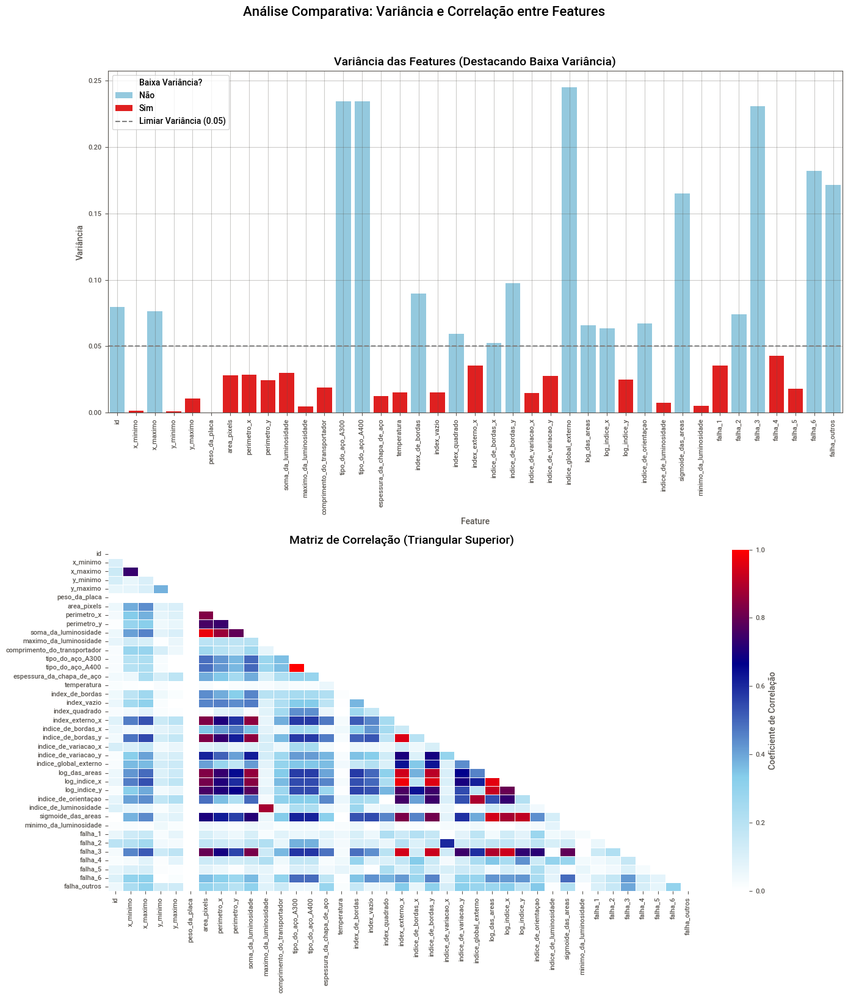


Resumo das Features Problemáticas:
                     Feature  Variância Baixa_Variância Alta_Correlação
                    x_minimo   0.001435             Sim             Não
                    y_minimo   0.001069             Sim             Não
                    y_maximo   0.010712             Sim             Não
               peso_da_placa   0.000000             Sim             Não
                 area_pixels   0.028023             Sim             Sim
                 perimetro_x   0.028538             Sim             Sim
                 perimetro_y   0.024227             Sim             Não
        soma_da_luminosidade   0.029754             Sim             Sim
      maximo_da_luminosidade   0.004639             Sim             Sim
comprimento_do_transportador   0.019102             Sim             Não
            tipo_do_aço_A300   0.234305             Não             Sim
   espessura_da_chapa_de_aço   0.012382             Sim             Não
                 temperatura

In [248]:
# Calcular variância com outro limiar e identificanda colunas com baixa variância
variancias = df_normalized_inliers.var()
limiar_var = 0.05
colunas_baixa_variancia = variancias[variancias < limiar_var].index.tolist()

# Matriz de correlação
corr_matrix = df_normalized_inliers.corr().abs()
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))
high_corr_cols = set()
for col in upper.columns:
    high_corr = upper[col][upper[col] > 0.8].index.tolist()
    if high_corr:
        high_corr_cols.update(high_corr)
        print(f"Coluna '{col}' está altamente correlacionada com: {high_corr}")

# Criando dataframe combinando informações de variância e correlação
df_plot = pd.DataFrame({
    'Feature': variancias.index,
    'Variância': variancias.values,
    'Baixa_Variância': np.where(variancias.index.isin(colunas_baixa_variancia), 'Sim', 'Não'),
    'Alta_Correlação': np.where(variancias.index.isin(high_corr_cols), 'Sim', 'Não')
})


fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(14, 16))

# Variância com destaque para variáveis problemáticas
sns.barplot(data=df_plot, x='Feature', y='Variância', hue='Baixa_Variância',
            palette={'Não': 'skyblue', 'Sim': 'red'}, dodge=False, ax=ax1)
ax1.axhline(y=limiar_var, color='gray', linestyle='--', label=f'Limiar Variância ({limiar_var})')
ax1.set_title('Variância das Features (Destacando Baixa Variância)', fontsize=14)
ax1.set_xticklabels(ax1.get_xticklabels(), rotation=90)
ax1.legend(title='Baixa Variância?')
ax1.grid(True, alpha=0.3)

# Matriz de correlação com anotações
mask = np.triu(np.ones_like(corr_matrix, dtype=bool))
cmap = LinearSegmentedColormap.from_list('rg', ["white", "skyblue", "darkblue", "red"], N=256)
sns.heatmap(corr_matrix, mask=mask, cmap=cmap, vmin=0, vmax=1,
            fmt=".2f", linewidths=.5, ax=ax2, cbar_kws={'label': 'Coeficiente de Correlação'})
ax2.set_title('Matriz de Correlação (Triangular Superior)', fontsize=14)
ax2.set_xticklabels(ax2.get_xticklabels(), rotation=90)
ax2.set_yticklabels(ax2.get_yticklabels(), rotation=0)

plt.suptitle('Análise Comparativa: Variância e Correlação entre Features', fontsize=16, y=1.02)

plt.tight_layout()
plt.show()

# Tabela resumo das features problemáticas
print("\nResumo das Features Problemáticas:")
problematic_features = df_plot[(df_plot['Baixa_Variância'] == 'Sim') | (df_plot['Alta_Correlação'] == 'Sim')]
print(problematic_features[['Feature', 'Variância', 'Baixa_Variância', 'Alta_Correlação']].to_string(index=False))

Baixa variância significa que os valores em um conjunto de dados estão próximos da média (valor esperado), indicando pouca dispersão ou variação entre eles. Em outras palavra, se a variância é baixa, os dados são mais homogêneos e consistentes, se a variância é alta, os dados estão mais espalhados em relação à média.

Coluna 'perimetro_x' está altamente correlacionada com: ['area_pixels']

* Coluna 'soma_da_luminosidade' está altamente correlacionada com: ['area_pixels', 'perimetro_x']
* Coluna 'tipo_do_aço_A400' está altamente correlacionada com: ['tipo_do_aço_A300']
* Coluna 'index_externo_x' está altamente correlacionada com: ['area_pixels', 'soma_da_luminosidade']
* Coluna 'indice_de_bordas_y' está altamente correlacionada com: ['area_pixels', 'soma_da_luminosidade', 'index_externo_x']
* Coluna 'log_das_areas' está altamente correlacionada com: ['area_pixels', 'soma_da_luminosidade', 'index_externo_x', 'indice_de_bordas_y']
* Coluna 'log_indice_x' está altamente correlacionada com: ['area_pixels', 'soma_da_luminosidade', 'index_externo_x', 'indice_de_bordas_y', 'log_das_areas']
* Coluna 'log_indice_y' está altamente correlacionada com: ['log_das_areas', 'log_indice_x']
* Coluna 'indice_de_orientaçao' está altamente correlacionada com: ['indice_global_externo']
* Coluna 'indice_de_luminosidade' está altamente correlacionada com: ['maximo_da_luminosidade']
* Coluna 'sigmoide_das_areas' está altamente correlacionada com: ['index_externo_x', 'indice_de_bordas_y', 'log_das_areas', 'log_indice_x', 'log_indice_y']
* Coluna 'falha_3' está altamente correlacionada com: ['soma_da_luminosidade', 'index_externo_x', 'indice_de_bordas_y', 'log_das_areas', 'log_indice_x']





In [249]:
# Lista de colunas a serem removidas baseado na minha interpretação das analises acima
colunas_remover = ['id', 'y_minimo', 'y_maximo', 'peso_da_placa',
                   'maximo_da_luminosidade', 'comprimento_do_transportador', 'temperatura',
                   'index_vazio', 'index_quadrado', 'indice_de_luminosidade', 'minimo_da_luminosidade']

# Removendo as colunas do DataFrame
df_filtrado = df_normalized_inliers.drop(columns=colunas_remover)

# Verifica as colunas restantes
print("Colunas restantes:", df_filtrado.columns.tolist())

Colunas restantes: ['x_minimo', 'x_maximo', 'area_pixels', 'perimetro_x', 'perimetro_y', 'soma_da_luminosidade', 'tipo_do_aço_A300', 'tipo_do_aço_A400', 'espessura_da_chapa_de_aço', 'index_de_bordas', 'index_externo_x', 'indice_de_bordas_x', 'indice_de_bordas_y', 'indice_de_variacao_x', 'indice_de_variacao_y', 'indice_global_externo', 'log_das_areas', 'log_indice_x', 'log_indice_y', 'indice_de_orientaçao', 'sigmoide_das_areas', 'falha_1', 'falha_2', 'falha_3', 'falha_4', 'falha_5', 'falha_6', 'falha_outros']


Aplicando novamente a matriz de correlação final

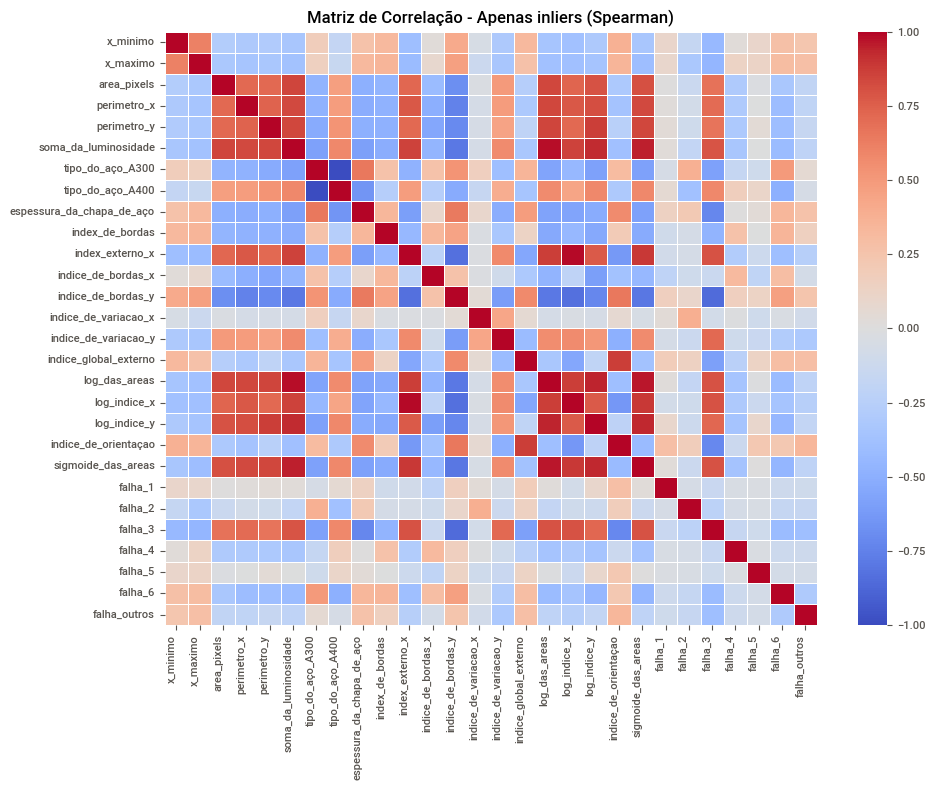

In [250]:
corr_matrix_final = df_filtrado.corr(method='spearman')

plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix_final, **heatmap_kws)
plt.title('Matriz de Correlação - Apenas inliers (Spearman)')
plt.xticks(rotation=90, ha='right')
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

<ipython-input-252-69cec24e607f>:5: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  Z = linkage(distance_matrix, 'complete')


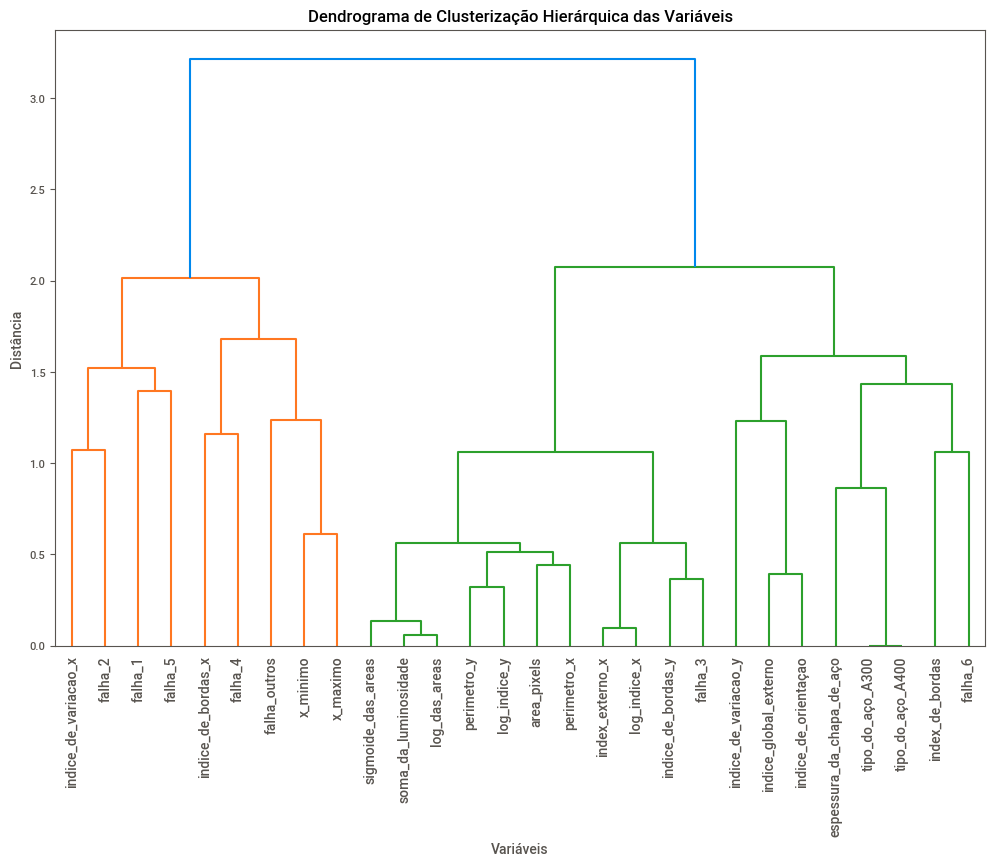

In [252]:
# Convertendo correlação para distância
distance_matrix = 1 - np.abs(corr_matrix_final)

# Aplicando linkage
Z = linkage(distance_matrix, 'complete')

# dendrograma
plt.figure(figsize=(12, 8))
dendrogram(Z, labels=distance_matrix.columns, orientation='top', leaf_rotation=90)
plt.title('Dendrograma de Clusterização Hierárquica das Variáveis')
plt.xlabel('Variáveis')
plt.ylabel('Distância')
plt.show()



Dada a relação vista no dendograma, vamos começar utilizando o modelo Random Forest

In [253]:
# Random Forest
# print(df_filtrado.info())

# Separando as variáveis independentes da dependente
y = df_filtrado.iloc[:,[21,22,23,24,25,26,27]].values # variáveis dependentes
X = df_filtrado.iloc[:,[0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20]].values # variáveis independentes
# X = df_filtrado.iloc[:,[2,3,4,5,10,12,13,14,16,17,18,19,20]].values # variáveis independentes
# Acurácia: 0.69 / Precisão: 0.79 / Recall: 0.69 / F1: 0.70

# Dividindo os dados em treino e teste

X_treinamento, X_teste, y_treinamento, y_teste = train_test_split(X, y, test_size=0.3, random_state=42)
# test_size indica a porção que eu quero utilizar para os meus dados de teste. Se eu colocar 0.30, ele usará 70% como
# treinamento e random_state é para repetir as amostras.

modelo = RandomForestClassifier(random_state=42)
modelo.fit(X_treinamento, y_treinamento)

previsoes = modelo.predict(X_teste)
probabilidades = modelo.predict_proba(X_teste)

acuracia = accuracy_score(y_teste, previsoes)
precisao = precision_score(y_teste, previsoes, average='weighted')
recall = recall_score(y_teste, previsoes, average='weighted')
f1 = f1_score(y_teste, previsoes, average='weighted')

print(f'Acurácia: {(acuracia):.2f} / Precisão: {precisao:.2f} / Recall: {recall:.2f} / F1: {f1:.2f}')
print()

# Analisando as cinco primeiro amostras
print("Probabilidades para as primeiras 5 amostras:")
for i in range(5):
    print(f"Amostra {i+1}:")
    for j, (falha, prob_array) in enumerate(zip(['falha_1', 'falha_2', 'falha_3', 'falha_4',
                                               'falha_5', 'falha_6', 'falha_outros'], probabilidades)):
        # prob_array é a matriz de probabilidades para esta falha específica
        # prob_array[i][1] é a probabilidade da classe positiva para a i-ésima amostra
        print(f" Probabilidade da {falha}: {prob_array[i][1]:.2%}")



Acurácia: 0.74 / Precisão: 0.82 / Recall: 0.74 / F1: 0.76

Probabilidades para as primeiras 5 amostras:
Amostra 1:
 Probabilidade da falha_1: 0.00%
 Probabilidade da falha_2: 0.00%
 Probabilidade da falha_3: 3.00%
 Probabilidade da falha_4: 81.00%
 Probabilidade da falha_5: 0.00%
 Probabilidade da falha_6: 13.00%
 Probabilidade da falha_outros: 3.00%
Amostra 2:
 Probabilidade da falha_1: 6.00%
 Probabilidade da falha_2: 8.00%
 Probabilidade da falha_3: 0.00%
 Probabilidade da falha_4: 0.00%
 Probabilidade da falha_5: 0.00%
 Probabilidade da falha_6: 61.00%
 Probabilidade da falha_outros: 25.00%
Amostra 3:
 Probabilidade da falha_1: 0.00%
 Probabilidade da falha_2: 3.00%
 Probabilidade da falha_3: 0.00%
 Probabilidade da falha_4: 0.00%
 Probabilidade da falha_5: 0.00%
 Probabilidade da falha_6: 92.00%
 Probabilidade da falha_outros: 5.00%
Amostra 4:
 Probabilidade da falha_1: 0.00%
 Probabilidade da falha_2: 0.00%
 Probabilidade da falha_3: 0.00%
 Probabilidade da falha_4: 86.00%
 Proba

Escolhendo uma amostra específica

In [254]:
num_amostras = len(X_teste)
print(f"Você tem {num_amostras} amostras. Qual deseja avaliar? (Digite um número entre 1 e {num_amostras})")

# Solicita a amostra que o usuário deseja avaliar
while True:
    try:
        amostra = int(input("Número da amostra: "))
        if 1 <= amostra <= num_amostras:
            break
        else:
            print(f"Por favor, digite um número entre 1 e {num_amostras}.")
    except ValueError:
        print("Por favor, digite um número válido.")

# Mostra as probabilidades para a amostra selecionada
print(f"\nProbabilidades de falha para a amostra {amostra}:")
for j, (falha, prob_array) in enumerate(zip(['falha_1', 'falha_2', 'falha_3', 'falha_4',
                                           'falha_5', 'falha_6', 'falha_outros'], probabilidades)):
    # prob_array[amostra-1][1] é a probabilidade da classe positiva para a amostra selecionada
    print(f" Probabilidade da {falha}: {prob_array[amostra-1][1]:.2%}")

Você tem 341 amostras. Qual deseja avaliar? (Digite um número entre 1 e 341)
Número da amostra: 2

Probabilidades de falha para a amostra 2:
 Probabilidade da falha_1: 6.00%
 Probabilidade da falha_2: 8.00%
 Probabilidade da falha_3: 0.00%
 Probabilidade da falha_4: 0.00%
 Probabilidade da falha_5: 0.00%
 Probabilidade da falha_6: 61.00%
 Probabilidade da falha_outros: 25.00%


Criando um dataframe para armazenar os resultados:

In [255]:
falhas = ['falha_1', 'falha_2', 'falha_3', 'falha_4', 'falha_5', 'falha_6', 'falha_outros']
dados_probabilidades = []

for i in range(len(X_teste)):
    linha = {'Amostra': i+1}
    for j, falha in enumerate(falhas):
        linha[falha] = probabilidades[j][i][1]
    dados_probabilidades.append(linha)

df_probabilidades = pd.DataFrame(dados_probabilidades)

# Salvando em um arquivo CSV
df_probabilidades.to_excel('probabilidades.xlsx', index=False)

print("Probabilidades para as primeiras 5 amostras:")
print(df_probabilidades.head().to_string(index=False))


Acurácia: 0.74 / Precisão: 0.82 / Recall: 0.74 / F1: 0.76

Probabilidades para as primeiras 5 amostras:
 Amostra  falha_1  falha_2  falha_3  falha_4  falha_5  falha_6  falha_outros
       1     0.00     0.00     0.03     0.81     0.00     0.13          0.03
       2     0.06     0.08     0.00     0.00     0.00     0.61          0.25
       3     0.00     0.03     0.00     0.00     0.00     0.92          0.05
       4     0.00     0.00     0.00     0.86     0.00     0.01          0.13
       5     0.16     0.03     0.00     0.00     0.31     0.00          0.50


Modelo utilizando Decision Tree Classifier

In [160]:
# # Decision Tree Classifier
# # print(df_filtrado.head())

# # Separando as variáveis independentes da dependente
# y = df_filtrado.iloc[:,[21,22,23,24,25,26,27]].values # variáveis dependentes
# X = df_filtrado.iloc[:,[0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20]].values # variáveis independentes
# # X = df_filtrado.iloc[:,[2,3,4,5,10,12,13,14,16,17,18,19,20]].values
# # Acurácia: 0.70 / Precisão: 0.70 / Recall: 0.70 / F1: 0.69

# # Dividindo os dados em treino e teste

# X_treinamento, X_teste, y_treinamento, y_teste = train_test_split(X, y, test_size=0.3, random_state=42)
# # test_size indica a porção que eu quero utilizar para os meus dados de teste. Se eu colocar 0.30, ele usará 70% como
# # treinamento e random_state é para repetir as amostras.

# modelo = DecisionTreeClassifier(random_state=42)
# modelo.fit(X_treinamento, y_treinamento)

# previsoes = modelo.predict(X_teste)
# probabilidades = modelo.predict_proba(X_teste)

# acuracia = accuracy_score(y_teste, previsoes)
# precisao = precision_score(y_teste, previsoes, average='weighted')
# recall = recall_score(y_teste, previsoes, average='weighted')
# f1 = f1_score(y_teste, previsoes, average='weighted')

# print(f'Acurácia: {acuracia:.2f} / Precisão: {precisao:.2f} / Recall: {recall:.2f} / F1: {f1:.2f}')
# print()

# # Analisando as cinco primeiro amostras
# print("Probabilidades para as primeiras 5 amostras:")
# for i in range(5):
#     print(f"Amostra {i+1}:")
#     for j, (falha, prob_array) in enumerate(zip(['falha_1', 'falha_2', 'falha_3', 'falha_4',
#                                                'falha_5', 'falha_6', 'falha_outros'], probabilidades)):
#         # prob_array é a matriz de probabilidades para esta falha específica
#         # prob_array[i][1] é a probabilidade da classe positiva para a i-ésima amostra
#         print(f" Probabilidade da {falha}: {prob_array[i][1]:.2%}")

Modelo utilizando K-Nearest Neighbors (KNN)

In [161]:
# # K-Nearest Neighbors (KNN)
# # print(df_filtrado.head())

# # Separando as variáveis independentes da dependente
# y = df_filtrado.iloc[:,[21,22,23,24,25,26,27]].values # variáveis dependentes
# X = df_filtrado.iloc[:,[0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20]].values # variáveis independentes
# # X = df_filtrado.iloc[:,[2,3,4,5,10,12,13,14,16,17,18,19,20]].values
# # Acurácia: 0.70 / Precisão: 0.75 / Recall: 0.70 / F1: 0.72

# # Dividindo os dados em treino e teste

# X_treinamento, X_teste, y_treinamento, y_teste = train_test_split(X, y, test_size=0.3, random_state=42)
# # test_size indica a porção que eu quero utilizar para os meus dados de teste. Se eu colocar 0.30, ele usará 70% como
# # treinamento e random_state é para repetir as amostras.

# modelo = KNeighborsClassifier(n_neighbors=3)
# modelo.fit(X_treinamento, y_treinamento)

# previsoes = modelo.predict(X_teste)
# probabilidades = modelo.predict_proba(X_teste)

# acuracia = accuracy_score(y_teste, previsoes)
# precisao = precision_score(y_teste, previsoes, average='weighted')
# recall = recall_score(y_teste, previsoes, average='weighted')
# f1 = f1_score(y_teste, previsoes, average='weighted')

# print(f'Acurácia: {acuracia:.2f} / Precisão: {precisao:.2f} / Recall: {recall:.2f} / F1: {f1:.2f}')
# print()

# # Analisando as cinco primeiro amostras
# print("Probabilidades para as primeiras 5 amostras:")
# for i in range(5):
#     print(f"Amostra {i+1}:")
#     for j, (falha, prob_array) in enumerate(zip(['falha_1', 'falha_2', 'falha_3', 'falha_4',
#                                                'falha_5', 'falha_6', 'falha_outros'], probabilidades)):
#         # prob_array é a matriz de probabilidades para esta falha específica
#         # prob_array[i][1] é a probabilidade da classe positiva para a i-ésima amostra
#         print(f" Probabilidade da {falha}: {prob_array[i][1]:.2%}")

Modelo utilizando Multilayer Percptron (MLP)

In [162]:
# # Multilayer Perceptron (MLP) para Classificação
# # print(df_filtrado.head())

# # Separando as variáveis independentes da dependente
# y = df_filtrado.iloc[:,[21,22,23,24,25,26,27]].values # variáveis dependentes
# X = df_filtrado.iloc[:,[0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20]].values # variáveis independentes
# # Acurácia: 0.76 / Precisão: 0.83 / Recall: 0.79 / F1: 0.79
# # Validation score: 0.787500 -> modelo não esta aprendendo bem

# # X = df_filtrado.iloc[:,[2,3,4,5,10,12,13,14,16,17,18,19,20]].values


# # Dividindo os dados em treino e teste

# X_treinamento, X_teste, y_treinamento, y_teste = train_test_split(X, y, test_size=0.3, random_state=42)
# # test_size indica a porção que eu quero utilizar para os meus dados de teste. Se eu colocar 0.30, ele usará 70% como
# # treinamento e random_state é para repetir as amostras.

# mlp = MLPClassifier(
#     hidden_layer_sizes=(20, 10),  # Mais neurônios
#     max_iter=5000,               # Mais épocas
#     early_stopping=True,         # Parar se não melhorar
#     n_iter_no_change=3000,         # Paciência para early stopping
#     verbose=True
# )

# # Treinar o modelo
# mlp.fit(X_treinamento, y_treinamento)

# previsoes = mlp.predict(X_teste)

# acuracia = accuracy_score(y_teste, previsoes)
# precisao = precision_score(y_teste, previsoes, average='weighted')
# recall = recall_score(y_teste, previsoes, average='weighted')
# f1 = f1_score(y_teste, previsoes, average='weighted')


# print(f'Acurácia: {acuracia:.2f} / Precisão: {precisao:.2f} / Recall: {recall:.2f} / F1: {f1:.2f}')
# print()

# plt.plot(mlp.loss_curve_)
# plt.title("Curva de Perda Durante o Treinamento")
# plt.xlabel("Épocas")
# plt.ylabel("Perda")
# plt.show()

# # Analisando as cinco primeiro amostras
# print("Probabilidades para as primeiras 5 amostras:")
# for i in range(5):
#     print(f"Amostra {i+1}:")
#     for j, (falha, prob_array) in enumerate(zip(['falha_1', 'falha_2', 'falha_3', 'falha_4',
#                                                'falha_5', 'falha_6', 'falha_outros'], probabilidades)):
#         # prob_array é a matriz de probabilidades para esta falha específica
#         # prob_array[i][1] é a probabilidade da classe positiva para a i-ésima amostra
#         print(f" Probabilidade da {falha}: {prob_array[i][1]:.2%}")

In [163]:
relatorio_sweetviz = sv.analyze(df_filtrado)
relatorio_sweetviz.show_html("analise_sweetviz.html")

                                             |          | [  0%]   00:00 -> (? left)

Report analise_sweetviz.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


In [166]:
relatorio_profile = ProfileReport(df_filtrado, title="Relatório Estatatístico", explorative=True)
relatorio_profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 28/28 [00:00<00:00, 56.07it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [256]:
from joblib import dump

# Salvar o modelo em um arquivo
dump(modelo, 'modelo_random_forest.joblib')

['modelo_random_forest.joblib']